In [234]:
import warnings
warnings.filterwarnings("ignore")
from anndata import AnnData
import scanpy as sc
import squidpy as sq
import pandas as pd
import numpy as np
import copy
import scipy.sparse as sp
import math
import os
import cv2
import skimage as ski
import matplotlib as mpl
import matplotlib.pyplot as plt
from PIL import Image
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True
Image.MAX_IMAGE_PIXELS = None

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score

from st_processing import dis_two_point,get_chip_coord,get_distance_from_point_to_line,get_piexl_coods,get_piexl_coods_Mchip,getLinearEquation_new
from st_processing import rgb2gray,adata_flip,adata_Srotate,trans_pN,make_uniq_list
from st_processing import get_adata_STARsolo,get_adata_STARsolo_10x
from st_processing import load_image,Srotate,list_remove_dup


color_list=['#1f77b4','#ff7f0e','#2ca02c','#d62728','#9467bd','#8c564b','#e377c2','#7f7f7f','#bcbd22','#17becf',
           '#a6cee3','#fdbf6f','#b2df8a','#fb9a99','#cab2d6']
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['font.sans-serif'] = 'Arial'

# plt.rcParams['figure.figsize']=(10,10)
# sns.set(style="ticks", font_scale=2)
geneinfo_path='/histor/zhao/pangkun/JupyterLab/Task/Public_data/reference/mm10/'
def interpolation_M9_70_brain(adata):
    raw_X=adata.X.A.copy()
    adata.obs['id']=adata.obs['sample']
    adata.obs['Pixel_col']=adata.obsm['spatial'][:,0]
    adata.obs['Pixel_row']=adata.obsm['spatial'][:,1]
    
    dis=adata.uns['spatial']['ZOO9-3']['scalefactors']['spot_diameter_fullres']*4
    adata.obs['Spot_col']=adata.obs['Spot_col'].astype(int)
    adata.obs['Spot_row']=adata.obs['Spot_row'].astype(int)
    adata.obs['Pixel_col']=adata.obs['Pixel_col'].astype(int)
    adata.obs['Pixel_row']=adata.obs['Pixel_row'].astype(int)
    import random
    #Spot_row =71  20< Spot_col <75
    for i in adata.obs.index[(adata.obs['Spot_row']==71) & (adata.obs['Spot_col']>20)& (adata.obs['Spot_col']<141)]:
        col=adata.obs.loc[i,'Pixel_col']
        row=adata.obs.loc[i,'Pixel_row']
        tmp_X=raw_X[(adata.obs['id']!='add')&(adata.obs['Pixel_col']<(col+dis)) & (adata.obs['Pixel_col']>(col-dis)) & 
                   (adata.obs['Pixel_row']<(row+dis)) & (adata.obs['Pixel_row']>(row-dis)) & (adata.obs['Spot_row']!=71)]
        if tmp_X.shape[0] > 0:
            tmp_X=tmp_X[random.randint(0, tmp_X.shape[0]-1),:]
            raw_X[adata.obs.index==i]=tmp_X
    #Spot_row =71  20< Spot_col <75
    for i in adata.obs.index[(adata.obs['Spot_row']==140) & (adata.obs['Spot_col']>70)& (adata.obs['Spot_col']<210)]:
        col=adata.obs.loc[i,'Pixel_col']
        row=adata.obs.loc[i,'Pixel_row']
        tmp_X=raw_X[(adata.obs['id']!='add')&(adata.obs['Pixel_col']<(col+dis)) & (adata.obs['Pixel_col']>(col-dis)) & 
                   (adata.obs['Pixel_row']<(row+dis)) & (adata.obs['Pixel_row']>(row-dis)) & (adata.obs['Spot_row']!=140)]
        if tmp_X.shape[0] > 0:
            tmp_X=tmp_X[random.randint(0, tmp_X.shape[0]-1),:]
            raw_X[adata.obs.index==i]=tmp_X 
    #Spot_row =141 Spot_col <75
    for i in adata.obs.index[adata.obs['Spot_row']==141]:
        col=adata.obs.loc[i,'Pixel_col']
        row=adata.obs.loc[i,'Pixel_row']
        tmp_X=raw_X[(adata.obs['id']!='add')&(adata.obs['Pixel_col']<(col+dis)) & (adata.obs['Pixel_col']>(col-dis)) & 
                   (adata.obs['Pixel_row']<(row+dis)) & (adata.obs['Pixel_row']>(row-dis)) & (adata.obs['Spot_row']!=141)]
        if tmp_X.shape[0] > 0:
            tmp_X=tmp_X[random.randint(0, tmp_X.shape[0]-1),:]
            raw_X[adata.obs.index==i]=tmp_X

    #Spot_row =141 Spot_col <75
    for i in adata.obs.index[adata.obs['Spot_row']==162]:
        col=adata.obs.loc[i,'Pixel_col']
        row=adata.obs.loc[i,'Pixel_row']
        tmp_X=raw_X[(adata.obs['id']!='add')&(adata.obs['Pixel_col']<(col+dis)) & (adata.obs['Pixel_col']>(col-dis)) & 
                   (adata.obs['Pixel_row']<(row+dis)) & (adata.obs['Pixel_row']>(row-dis)) & (adata.obs['Spot_row']!=162)]
        if tmp_X.shape[0] > 0:
            tmp_X=tmp_X[random.randint(0, tmp_X.shape[0]-1),:]
            raw_X[adata.obs.index==i]=tmp_X

    # Spot_col =21
    for i in adata.obs.index[adata.obs['Spot_col']==21]:
        col=adata.obs.loc[i,'Pixel_col']
        row=adata.obs.loc[i,'Pixel_row']
        tmp_X=raw_X[(adata.obs['id']!='add')&(adata.obs['Pixel_col']<(col+dis)) & (adata.obs['Pixel_col']>(col-dis)) & 
                   (adata.obs['Pixel_row']<(row+dis)) & (adata.obs['Pixel_row']>(row-dis)) & (adata.obs['Spot_col']!=21)]
        if tmp_X.shape[0] > 0:
            tmp_X=tmp_X[random.randint(0, tmp_X.shape[0]-1),:]
            raw_X[adata.obs.index==i]=tmp_X
    # Spot_col =21
    for i in adata.obs.index[adata.obs['Spot_col']==30]:
        col=adata.obs.loc[i,'Pixel_col']
        row=adata.obs.loc[i,'Pixel_row']
        tmp_X=raw_X[(adata.obs['id']!='add')&(adata.obs['Pixel_col']<(col+dis)) & (adata.obs['Pixel_col']>(col-dis)) & 
                   (adata.obs['Pixel_row']<(row+dis)) & (adata.obs['Pixel_row']>(row-dis)) & (adata.obs['Spot_col']!=30)]
        if tmp_X.shape[0] > 0:
            tmp_X=tmp_X[random.randint(0, tmp_X.shape[0]-1),:]
            raw_X[adata.obs.index==i]=tmp_X
    for i in adata.obs.index[adata.obs['Spot_col']==60]:
        col=adata.obs.loc[i,'Pixel_col']
        row=adata.obs.loc[i,'Pixel_row']
        tmp_X=raw_X[(adata.obs['id']!='add')&(adata.obs['Pixel_col']<(col+dis)) & (adata.obs['Pixel_col']>(col-dis)) & 
                   (adata.obs['Pixel_row']<(row+dis)) & (adata.obs['Pixel_row']>(row-dis)) & (adata.obs['Spot_col']!=60)]
        if tmp_X.shape[0] > 0:
            tmp_X=tmp_X[random.randint(0, tmp_X.shape[0]-1),:]
            raw_X[adata.obs.index==i]=tmp_X
    
    for i in adata.obs.index[adata.obs['id']=='add']:
        col=adata.obs.loc[i,'Pixel_col']
        row=adata.obs.loc[i,'Pixel_row']
        tmp_X=raw_X[(adata.obs['id']!='add')&(adata.obs['Pixel_col']<(col+dis)) & (adata.obs['Pixel_col']>(col-dis)) & 
                      (adata.obs['Pixel_row']<(row+dis)) & (adata.obs['Pixel_row']>(row-dis))]
        if tmp_X.shape[0] > 0:
            tmp_X=tmp_X[random.randint(0, tmp_X.shape[0]-1),:]
            raw_X[adata.obs.index==i]=tmp_X
    
    adata.X=sp.csr_matrix(raw_X)
    sc.pp.calculate_qc_metrics(adata, qc_vars=["mt","rp","hb"], inplace=True)
    return adata

# 一、加载数据

## ZOO9-3

In [3]:

sample='ZOO9-3'
file_path='/Project/MAGIC_seq/Mouse_Adult_Brain_M9_70_15um/data/result_STARsolo/'+sample+'/STARsolo/'
image_file_path='/Project/MAGIC_seq/Mouse_Adult_Brain_M9_70_15um/data/Image/'
Barcode_file_path='/Project/MAGIC_seq/Mouse_Adult_Brain_M9_70_15um/data/Barcode-M9-70/'

res_um=15 #点直径
channels_num=210 #通道数
barcode_num=70 #barcode数
reg='reg1' #区域
chip_type='M9'

print(f'sample: {sample}')

HE_point1=(138,169)
Spot_point1=(112,227)
HE_point2=(4840,4691)
Spot_point2=(4827, 4720)#

line_point_r1c1=(735,694) 
line_point_r1c70=(740,4426)
line_point_r70c1=(4461,669)

sample: ZOO9-3


In [ ]:
adata=get_adata_STARsolo(sample,chip_type,reg,channels_num,barcode_num,res_um=res_um,add_M9_15=True,
                        img_file=True,EM=True,Velocyto=True,soloFeatures='GeneFull',raw=True,species='mouse',
                        file_path=file_path,image_file_path=image_file_path,Barcode_file_path=Barcode_file_path,geneinfo_path=geneinfo_path,
                        HE_point1=HE_point1,Spot_point1=Spot_point1,HE_point2=HE_point2,Spot_point2=Spot_point2,
                        line_point_r1c1=line_point_r1c1,line_point_r1c70=line_point_r1c70,line_point_r70c1=line_point_r70c1)
adata.write('adata_brain_M9.h5ad')

## S6

In [ ]:

sample='S6_new'
file_path='/Project/MAGIC_seq/Mouse_Adult_HIP_T3_70_15um/data/result_STARsolo/'+sample+'/STARsolo/'
image_file_path='/Project/MAGIC_seq/Mouse_Adult_HIP_T3_70_15um/data/Image/'
Barcode_file_path='/Project/MAGIC_seq/Mouse_Adult_HIP_T3_70_15um/data/Barcode-T3-70/'
res_um=15 #点直径
channels_num=70 #通道数
barcode_num=70 #barcode数
reg='reg1'
chip_type='T3'

HE_point1=(850,985)
Spot_point1=(895,943)
HE_point2=(4018,4123)
Spot_point2=(4069, 4067)

line_point_r1c1=(1397,1419)  
line_point_r1c70=(1396,3504) 
line_point_r70c1=(3483,1415)
adata=get_adata_STARsolo(sample,chip_type,reg,channels_num,barcode_num,res_um=res_um,only_HE=False,
                        img_file=True,EM=True,Velocyto=True,soloFeatures='GeneFull',raw=True,species='mouse',
                        file_path=file_path,image_file_path=image_file_path,Barcode_file_path=Barcode_file_path,geneinfo_path=geneinfo_path,
                        HE_point1=HE_point1,Spot_point1=Spot_point1,HE_point2=HE_point2,Spot_point2=Spot_point2,
                        line_point_r1c1=line_point_r1c1,line_point_r1c70=line_point_r1c70,line_point_r70c1=line_point_r70c1)
adata.write('adata_HIP_T3.h5ad')

# 二、重新导入-cell2location

In [2]:
import cell2location
import scvi
from cell2location.utils.filtering import filter_genes

from os import makedirs
from os.path import exists


result_folder='../file/Mouse_Adult_Brain_M9/cell2location_result'
ref_run_name=f'{result_folder}/reference_signatures'
run_name1=f'{result_folder}/cell2location_map_st1'
run_name2=f'{result_folder}/cell2location_map_st2'

run_nameS6=f'{result_folder}/cell2location_map_st_S6'


if not exists(ref_run_name):
    makedirs(ref_run_name)
if not exists(run_name1):
    makedirs(run_name1)
if not exists(run_name2):
    makedirs(run_name2)
    
if not exists(run_nameS6):
    makedirs(run_nameS6)

## 2.1.导入单细胞数据

In [90]:
df_cell_annotation=pd.read_csv("/histor/zhao/pangkun/JupyterLab/Task/Public_data/cell2location/cell_annotation.csv")
df_cell_annotation.index=df_cell_annotation['Cell ID']
df_cell_annotation

,Cell ID,sample,annotation_1,annotation_1_print
Cell ID,,,,
5705STDY8058283_AAACCCAAGCCTATTG-1,5705STDY8058283_AAACCCAAGCCTATTG-1,5705STDY8058283,Ext_L23,22_Ext_L23
5705STDY8058283_AAACCCAAGGTCATAA-1,5705STDY8058283_AAACCCAAGGTCATAA-1,5705STDY8058283,Oligo_2,59_Oligo_2
5705STDY8058283_AAACCCACAACCCTCT-1,5705STDY8058283_AAACCCACAACCCTCT-1,5705STDY8058283,Oligo_2,59_Oligo_2
5705STDY8058283_AAACCCAGTGCTATTG-1,5705STDY8058283_AAACCCAGTGCTATTG-1,5705STDY8058283,Astro_THAL_med,10_Astro_THAL_med
5705STDY8058283_AAACCCAGTTCACCGG-1,5705STDY8058283_AAACCCAGTTCACCGG-1,5705STDY8058283,Inh_Sst,49_Inh_Sst
...,...,...,...,...
5705STDY8058280_TTTGTTGCAGAGTGAC-1,5705STDY8058280_TTTGTTGCAGAGTGAC-1,5705STDY8058280,Micro,53_Micro
5705STDY8058280_TTTGTTGCATCGCTCT-1,5705STDY8058280_TTTGTTGCATCGCTCT-1,5705STDY8058280,Oligo_2,59_Oligo_2
5705STDY8058280_TTTGTTGGTATGGTAA-1,5705STDY8058280_TTTGTTGGTATGGTAA-1,5705STDY8058280,Inh_Meis2_3,46_Inh_Meis2_3


In [95]:
if 'adata_raw_sc' in globals():
    del adata_raw_sc

for sample in set(df_cell_annotation['sample']):
    print(sample)
    if 'adata_raw_sc' in globals():
        adata_1=sc.read_10x_h5('/histor/zhao/pangkun/JupyterLab/Task/Public_data/cell2location/'+sample+'_filtered_feature_bc_matrix.h5')
        adata_1.var['Symbol'] = adata_1.var_names
        adata_1.var.set_index('gene_ids', drop=True, inplace=True)
        adata_1.obs_names=[sample+'_'+i for i in adata_1.obs_names]
        adata_1.obs['sample']=sample
        adata_1=adata_1[[i in df_cell_annotation.index for i in adata_1.obs_names]]
        adata_1.obs['annotation_1']=df_cell_annotation.loc[adata_1.obs_names,'annotation_1']
        adata_1.obs['annotation_1_print']=df_cell_annotation.loc[adata_1.obs_names,'annotation_1_print']
        adata_raw_sc = adata_raw_sc.concatenate(adata_1,join='outer')
        
    else:
        adata_1=sc.read_10x_h5('/histor/zhao/pangkun/JupyterLab/Task/Public_data/cell2location/'+sample+'_filtered_feature_bc_matrix.h5')
        adata_1.var['Symbol'] = adata_1.var_names
        adata_1.var.set_index('gene_ids', drop=True, inplace=True)
        adata_1.obs_names=[sample+'_'+i for i in adata_1.obs_names]
        adata_1.obs['sample']=sample
        adata_1=adata_1[[i in df_cell_annotation.index for i in adata_1.obs_names]]
        adata_1.obs['annotation_1']=df_cell_annotation.loc[adata_1.obs_names,'annotation_1']
        adata_1.obs['annotation_1_print']=df_cell_annotation.loc[adata_1.obs_names,'annotation_1_print']

        adata_raw_sc = adata_1.copy()

5705STDY8058280
5705STDY8058284
5705STDY8058282
5705STDY8058285
5705STDY8058281
5705STDY8058283


In [96]:
adata_raw_sc

AnnData object with n_obs × n_vars = 40532 × 31053
    obs: 'sample', 'annotation_1', 'annotation_1_print', 'batch'
    var: 'feature_types', 'genome', 'Symbol'

In [99]:
sc.pp.filter_genes(adata_raw_sc, min_cells=10)

In [101]:
adata_raw_sc=adata_raw_sc[adata_raw_sc.obs['annotation_1']!='Unk_1']
adata_raw_sc=adata_raw_sc[adata_raw_sc.obs['annotation_1']!='Unk_2']
adata_raw_sc=adata_raw_sc[adata_raw_sc.obs['annotation_1']!='LowQ_1']
adata_raw_sc=adata_raw_sc[adata_raw_sc.obs['annotation_1']!='LowQ_2']
adata_raw_sc

View of AnnData object with n_obs × n_vars = 39208 × 23289
    obs: 'sample', 'annotation_1', 'annotation_1_print', 'batch'
    var: 'feature_types', 'genome', 'Symbol', 'n_cells'

In [102]:
adata_raw_sc.write("/histor/zhao/pangkun/JupyterLab/Task/Public_data/cell2location/adata_raw_sc.h5ad")

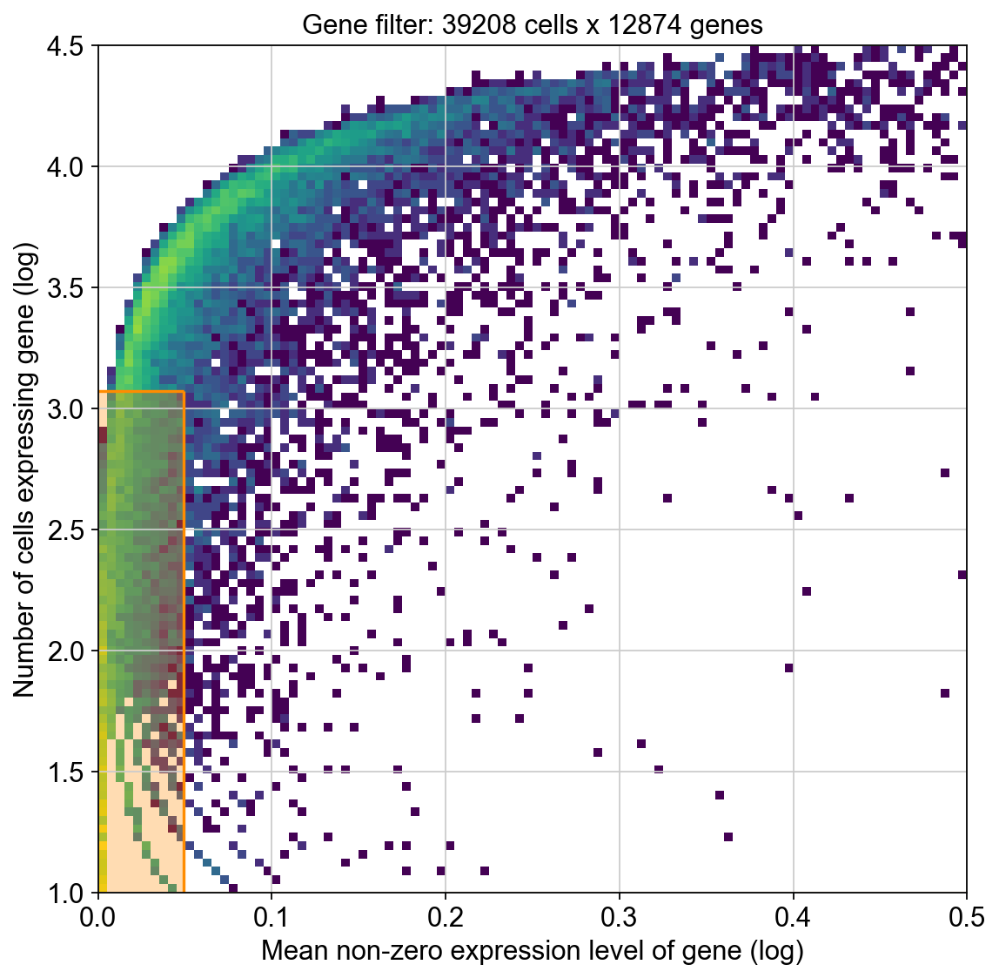

In [103]:
from cell2location.utils.filtering import filter_genes
selected = filter_genes(adata_raw_sc, cell_count_cutoff=5, cell_percentage_cutoff2=0.03, nonz_mean_cutoff=1.12)
# filter the object
adata_filter_sc = adata_raw_sc[:, selected].copy() 

In [104]:
adata_filter_sc

AnnData object with n_obs × n_vars = 39208 × 12874
    obs: 'sample', 'annotation_1', 'annotation_1_print', 'batch'
    var: 'feature_types', 'genome', 'Symbol', 'n_cells', 'nonz_mean'

In [107]:
# prepare anndata for the regression model
cell2location.models.RegressionModel.setup_anndata(adata=adata_filter_sc,
                        batch_key='sample',
                        labels_key='annotation_1',
                        categorical_covariate_keys=None
                       )

No GPU/TPU found, falling back to CPU. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)


In [108]:
# create the regression model
from cell2location.models import RegressionModel
mod = RegressionModel(adata_filter_sc)

# view anndata_setup as a sanity check
mod.view_anndata_setup()

Anndata setup with scvi-tools version 1.0.3.

Setup via `RegressionModel.setup_anndata` with arguments:

{
│   'layer': None,
│   'batch_key': 'sample',
│   'labels_key': 'annotation_1',
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_batch          │   6   │
│         n_cells          │ 39208 │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
│         n_labels         │  55   │
│          n_vars          │ 12874 │
└──────────────────────────┴───────┘

               Data Registry                
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃    scvi-tools Location    ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │          adata.X          │
│    batch     │ adata.obs['_scvi_batch']  │
│    ind_x     │   adata.obs['_indices']   │
│    labels    │ adata.obs['_scvi_labels'] │
└──────────────┴───────────────────────────┘

                     batch State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃   Source Location   ┃   Categories    ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['sample'] │ 5705STDY8058280 │          0          │
│                     │ 5705STDY8058281 │          1          │
│                     │ 5705STDY8058282 │          2          │
│                     │ 5705STDY8058283 │          3          │
│                     │ 5705STDY8058284 │          4          │
│                     │ 5705STDY8058285 │          5          │
└─────────────────────┴─────────────────┴─────────────────────┘

                       labels State Registry                        
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃   Categories   ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['annotation_1'] │   Astro_AMY    │          0          │
│                           │ Astro_AMY_CTX  │          1          │
│                           │   Astro_CTX    │          2          │
│                           │   Astro_HPC    │          3          │
│                           │   Astro_HYPO   │          4          │
│                           │   Astro_STR    │          5          │
│                           │ Astro_THAL_hab │          6          │
│                           │ Astro_THAL_lat │          7          │
│                           │ Astro_THAL_med │          8          │
│                           │    Astro_WM    │          9          │
│                           │      Endo      │         10          │
│                           │   Ext_Amy_1    │         11          │
│                           │   Ext_Amy_2    │         12          │
│                           │  Ext_ClauPyr   │         13          │
│                           │  Ext_Hpc_CA1   │         14          │
│                           │  Ext_Hpc_CA2   │         15          │
│                           │  Ext_Hpc_CA3   │         16          │
│                           │  Ext_Hpc_DG1   │         17          │
│                           │  Ext_Hpc_DG2   │         18          │
│                           │    Ext_L5_1    │         19          │
│                           │    Ext_L5_2    │         20          │
│                           │    Ext_L5_3    │         21          │
│                           │     Ext_L6     │         22          │
│                           │    Ext_L6B     │         23          │
│                           │    Ext_L23     │         24          │
│                           │    Ext_L25     │         25          │
│                           │    Ext_L56     │         26          │
│                           │    Ext_Med     │         27          │
│                           │    Ext_Pir     │         28          │
│                           │   Ext_Thal_1   │         29          │
│                           │   Ext_Thal_2   │         30          │
│                           │   Ext_Unk_1    │         31          │
│                           │   Ext_Unk_2    │         32          │
│                           │   Ext_Unk_3    │         33          │
│                           │     Inh_1      │         34          │
│                           │     Inh_2      │         35          │
│                           │     Inh_3      │         36          │
│                           │     Inh_4      │         37          │
│                           │     Inh_5      │         38          │
│                           │     Inh_6      │         39          │
│                           │   Inh_Lamp5    │         40          │
│                           │  Inh_Meis2_1   │         41          │
│                           │  Inh_Meis2_2   │         42          │
│                           │  Inh_Meis2_3   │         43          │
│                           │  Inh_Meis2_4   │         44          │
│                           │   Inh_Pvalb    │         45          │
│                           │    Inh_Sst     │         46          │
│                           │    Inh_Vip     │         47          │
│                           │     Micro      │         48          │
│                           │      Nb_1      │         49          │
│                           │      Nb_2      │         50          │
│                           │     OPC_1      │         51          │
│                           │     OPC_2      │         52          │
│                           │    Oligo_1     │         53          

In [109]:
mod.train(max_epochs=250, use_gpu=True)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA GeForce RTX 3090') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 250/250: 100%|██████████| 250/250 [12:41<00:00,  3.05s/it, v_num=1, elbo_train=2.48e+8]

`Trainer.fit` stopped: `max_epochs=250` reached.


Epoch 250/250: 100%|██████████| 250/250 [12:41<00:00,  3.05s/it, v_num=1, elbo_train=2.48e+8]


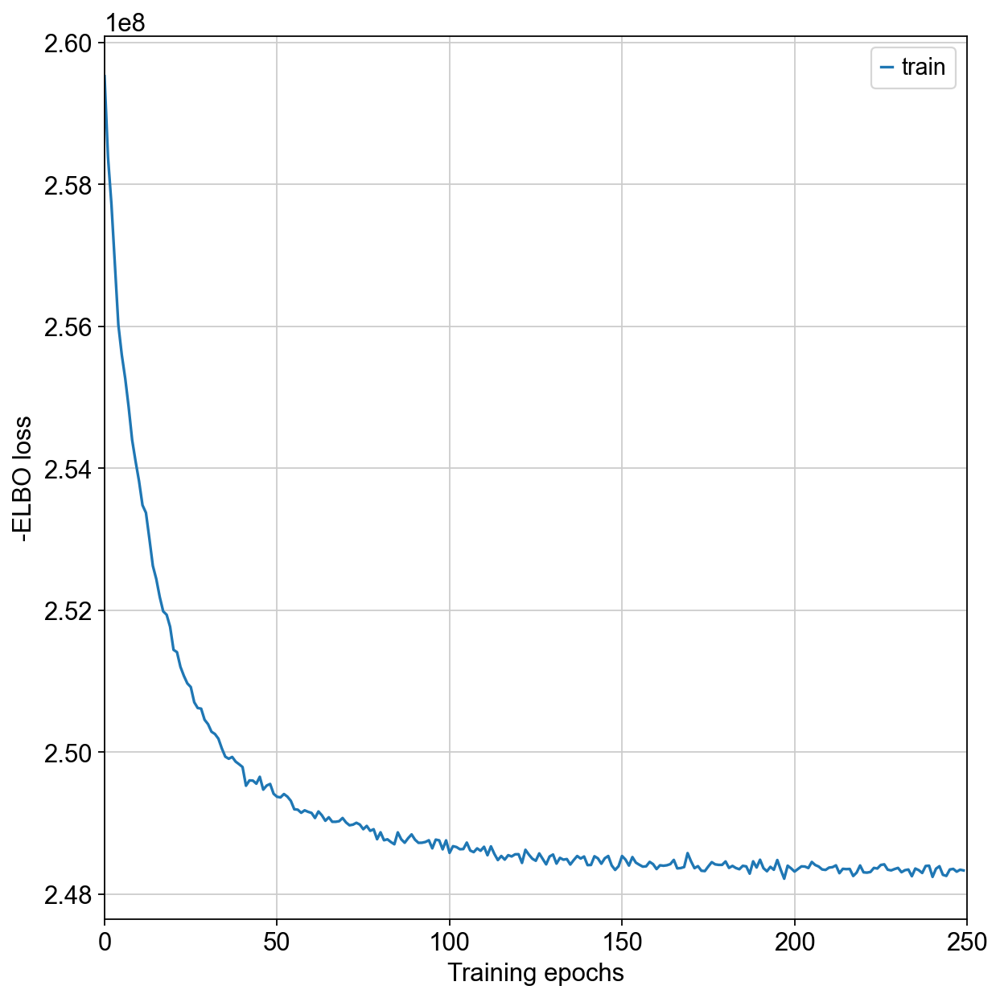

In [110]:
mod.plot_history(0)

In [ ]:
# In this section, we export the estimated cell abundance (summary of the posterior distribution).
adata_filter_sc = mod.export_posterior(
    adata_filter_sc, 
    sample_kwargs = {'num_samples': 1000, 'batch_size': 2500, 'use_gpu': False},
    export_slot = 'mod',
    add_to_varm = ["means","stds","q05","q95"],
    scale_average_detection = True
)



In [113]:
# Save model
mod.save(f"{ref_run_name}", overwrite=True)

# Save anndata object with results
adata_file = f"{ref_run_name}/sc.h5ad"
adata_filter_sc.write(adata_file)
adata_file

'../file/Mouse_Adult_Brain_M9/cell2location_result/reference_signatures/sc.h5ad'

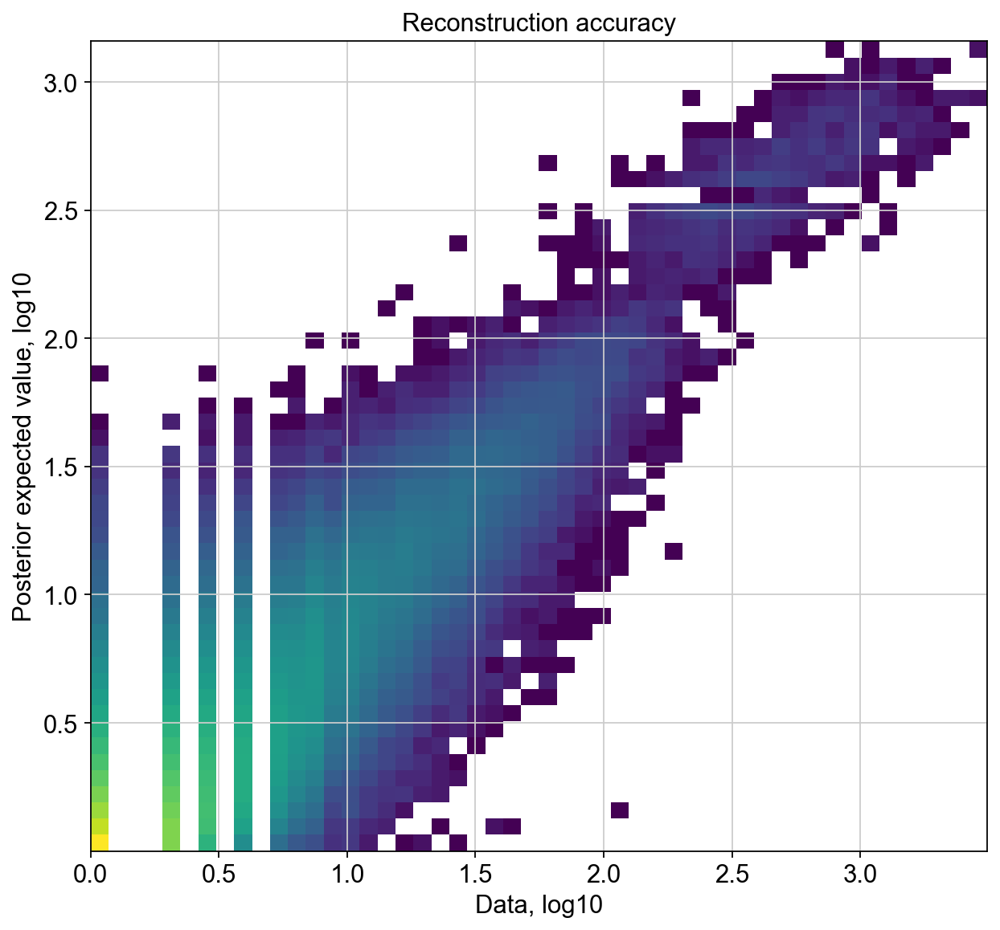

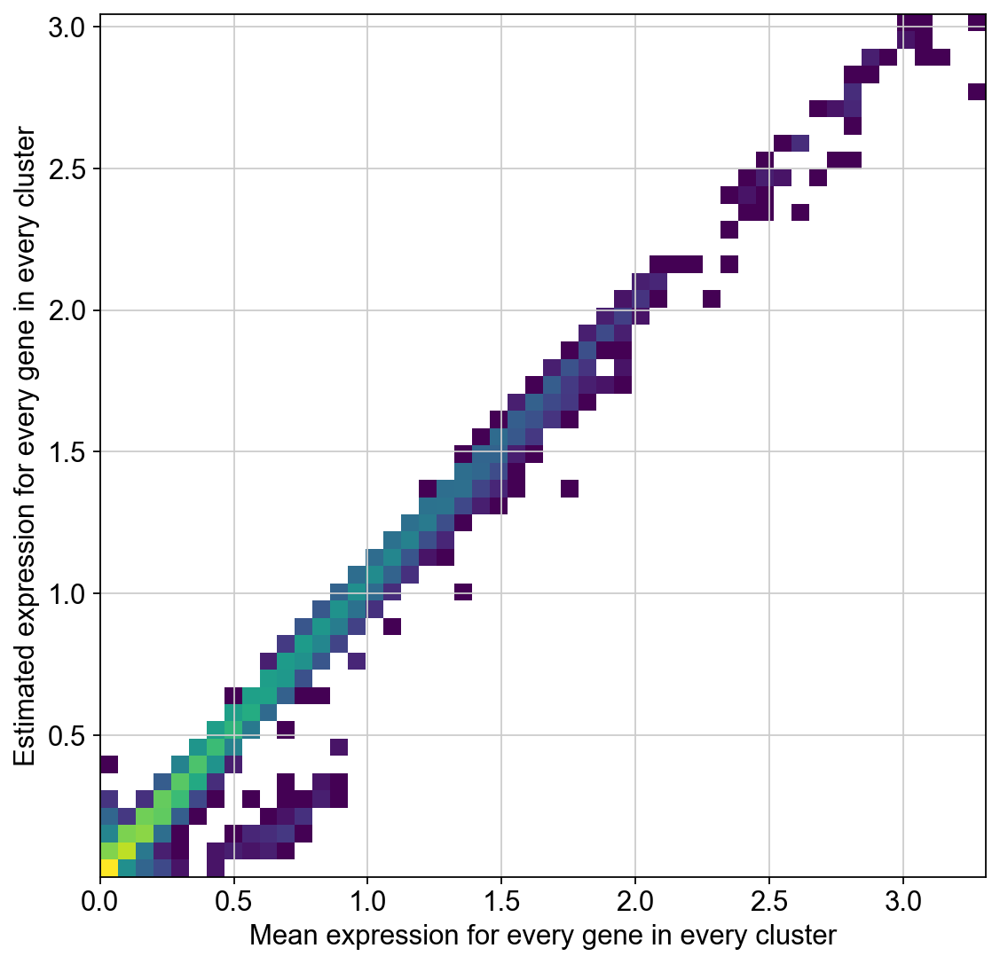

In [114]:
mod.plot_QC()

In [115]:
# export estimated expression in each cluster
if 'means_per_cluster_mu_fg' in adata_filter_sc.varm.keys():
    inf_aver = adata_filter_sc.varm['means_per_cluster_mu_fg'][[f'means_per_cluster_mu_fg_{i}'
                                    for i in adata_filter_sc.uns['mod']['factor_names']]].copy()
else:
    inf_aver = adata_filter_sc.var[[f'means_per_cluster_mu_fg_{i}'
                                    for i in adata_filter_sc.uns['mod']['factor_names']]].copy()
inf_aver.columns = adata_filter_sc.uns['mod']['factor_names']
inf_aver.iloc[0:5, 0:5]

,Astro_AMY,Astro_AMY_CTX,Astro_CTX,Astro_HPC,Astro_HYPO
gene_ids,,,,,
ENSMUSG00000051951,0.042601,0.081534,0.060292,0.063000,0.087954
ENSMUSG00000089699,0.004879,0.006379,0.009311,0.007778,0.015839
ENSMUSG00000025902,0.002111,0.004622,0.002529,0.004099,0.002328
ENSMUSG00000033845,0.118627,0.058361,0.099938,0.070623,0.083766
ENSMUSG00000033813,0.100626,0.110072,0.144036,0.103936,0.097587


In [116]:
inf_aver.to_csv(f'{ref_run_name}/inf_aver.csv')

In [118]:
inf_aver=pd.read_csv(f'{ref_run_name}/inf_aver.csv',index_col=0)
inf_aver

,Astro_AMY,Astro_AMY_CTX,Astro_CTX,Astro_HPC,Astro_HYPO,Astro_STR,Astro_THAL_hab,Astro_THAL_lat,Astro_THAL_med,Astro_WM,...,Inh_Pvalb,Inh_Sst,Inh_Vip,Micro,Nb_1,Nb_2,OPC_1,OPC_2,Oligo_1,Oligo_2
gene_ids,,,,,,,,,,,,,,,,,,,,,
ENSMUSG00000051951,0.042601,0.081534,0.060292,0.063000,0.087954,0.010979,0.042981,0.077356,0.103573,0.170392,...,16.454659,18.132910,6.995956,0.061452,2.559135,0.752929,2.428206,0.989592,2.398609,1.052666
ENSMUSG00000089699,0.004879,0.006379,0.009311,0.007778,0.015839,0.036412,0.024040,0.006066,0.005783,0.029372,...,3.080297,3.423546,1.209544,0.002760,0.563527,0.158895,0.427009,0.192112,0.464288,0.194403
ENSMUSG00000025902,0.002111,0.004622,0.002529,0.004099,0.002328,0.011542,0.025457,0.003084,0.002908,0.005166,...,0.001432,0.001590,0.003279,0.000863,0.005046,0.005189,0.001066,0.003712,0.001833,0.000109
ENSMUSG00000033845,0.118627,0.058361,0.099938,0.070623,0.083766,0.042370,0.092207,0.091948,0.123250,0.068933,...,0.305319,0.285921,0.162476,0.045502,0.108822,0.108675,0.093832,0.099644,0.087663,0.061965
ENSMUSG00000033813,0.100626,0.110072,0.144036,0.103936,0.097587,0.137919,0.094794,0.074043,0.089099,0.085188,...,0.352075,0.291735,0.254246,0.075248,0.106210,0.133248,0.121658,0.194394,0.147401,0.076747
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ENSMUSG00000064370,0.156608,0.129919,0.106922,0.124316,0.070386,0.102247,0.260560,0.088987,0.073867,0.335010,...,0.396708,0.292901,0.216999,0.045196,0.135088,0.079215,0.113445,0.116283,0.049753,0.060876
ENSMUSG00000051412,0.042457,0.043411,0.050663,0.055680,0.043572,0.080046,0.022365,0.035231,0.042913,0.073918,...,0.095077,0.127408,0.115367,0.015268,0.065699,0.069284,0.086705,0.110041,0.104885,0.072724
ENSMUSG00000079834,0.255009,0.272143,0.342369,0.247200,0.289931,0.448424,0.194617,0.353447,0.343521,0.090001,...,0.463170,0.515783,0.404815,0.076712,0.110933,0.036833,0.321997,0.336196,0.292600,0.133100


## 2.2导入ST数据

In [150]:
adata_M_brain = sc.read('/Project/MAGIC_seq/file/Mouse_Adult_Brain_M9/st_adata/adata_brain_M9.h5ad')
adata_M_brain=adata_M_brain[(adata_M_brain.obs['sample']!='add') & (adata_M_brain.obs['in_tissue']=='1')]

adata_M_brain.var["mt"] = adata_M_brain.var.Symbol.str.startswith("mt-")
adata_M_brain = adata_M_brain[:, ~adata_M_brain.var['mt'].values]

### spatial-1

In [123]:
adata_st=adata_M_brain[0:15000,]

In [127]:
inf_aver=pd.read_csv(f'{ref_run_name}/inf_aver.csv',index_col=0)
# find shared genes and subset both anndata and reference signatures
intersect = np.intersect1d(adata_st.var_names, inf_aver.index)
adata_st = adata_st[:, intersect].copy()
inf_aver = inf_aver.loc[intersect, :].copy()

# prepare anndata for cell2location model
cell2location.models.Cell2location.setup_anndata(adata=adata_st, batch_key="sample")

In [128]:
adata_st

AnnData object with n_obs × n_vars = 15000 × 12196
    obs: 'sample', 'Spot_col', 'Spot_row', 'in_tissue', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_rp', 'log1p_total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', '_indices', '_scvi_batch', '_scvi_labels'
    var: 'Symbol', 'Gene_type', 'mt', 'rp', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'HE_col', 'HE_row', 'spatial', '_scvi_uuid', '_scvi_manager_uuid'
    obsm: 'spatial'
    layers: 'spliced', 'unspliced'

In [129]:
# create and train the model
mod = cell2location.models.Cell2location(
    adata_st, cell_state_df=inf_aver,
    N_cells_per_location=1,
    detection_alpha=20, 
    detection_mean_per_sample=False 
)
mod.view_anndata_setup()

Anndata setup with scvi-tools version 1.0.3.

Setup via `Cell2location.setup_anndata` with arguments:

{
│   'layer': None,
│   'batch_key': 'sample',
│   'labels_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_batch          │   1   │
│         n_cells          │ 15000 │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
│         n_labels         │   1   │
│          n_vars          │ 12196 │
└──────────────────────────┴───────┘

               Data Registry                
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃    scvi-tools Location    ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │          adata.X          │
│    batch     │ adata.obs['_scvi_batch']  │
│    ind_x     │   adata.obs['_indices']   │
│    labels    │ adata.obs['_scvi_labels'] │
└──────────────┴───────────────────────────┘

                   batch State Registry                   
┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃   Source Location   ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['sample'] │   ZOO9-3   │          0          │
└─────────────────────┴────────────┴─────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

In [130]:
mod.train(max_epochs=30000,
          batch_size=None,
          use_gpu=True,
         )



GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 30000/30000: 100%|██████████| 30000/30000 [1:56:45<00:00,  4.26it/s, v_num=1, elbo_train=5.43e+7]  

`Trainer.fit` stopped: `max_epochs=30000` reached.


Epoch 30000/30000: 100%|██████████| 30000/30000 [1:56:45<00:00,  4.28it/s, v_num=1, elbo_train=5.43e+7]


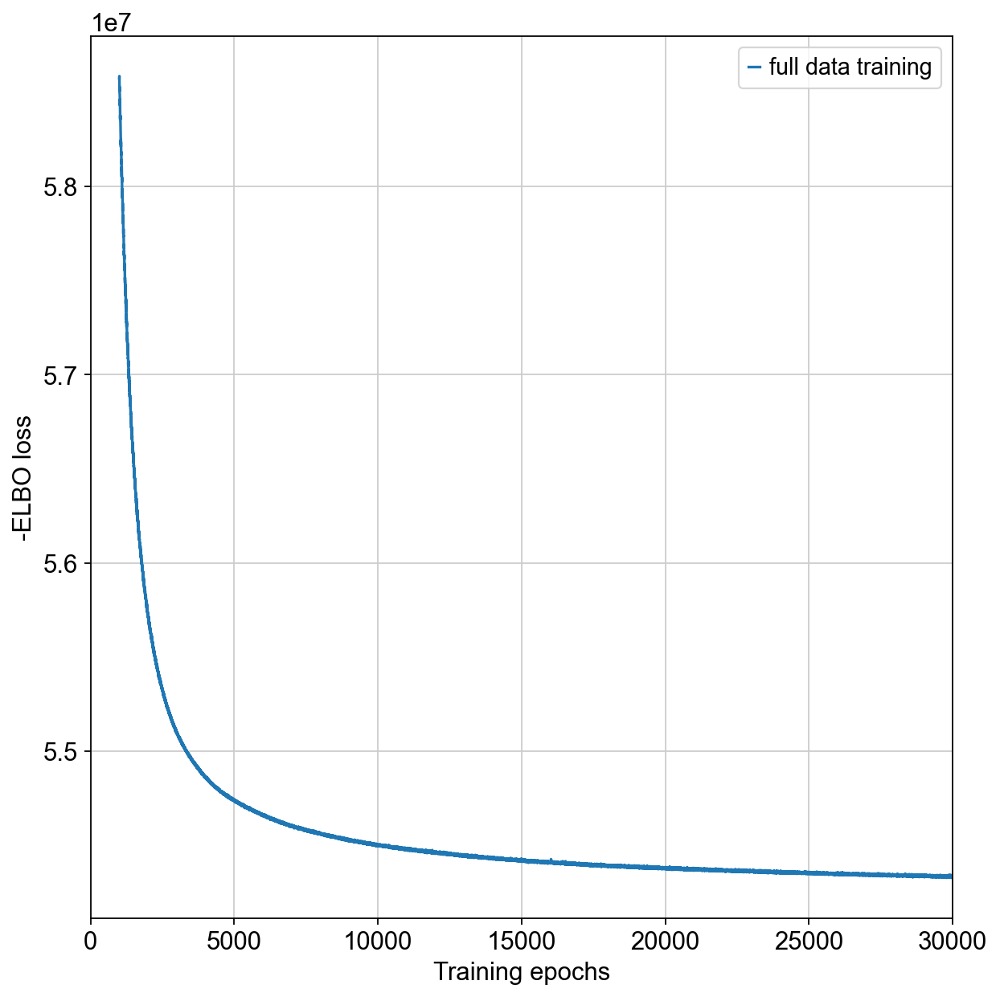

In [131]:
# plot ELBO loss history during training, removing first 100 epochs from the plot
mod.plot_history(1000)
plt.legend(labels=['full data training']);

In [132]:
# In this section, we export the estimated cell abundance (summary of the posterior distribution).
adata_st = mod.export_posterior(
    adata_st, sample_kwargs={'num_samples': 1000, 'batch_size': mod.adata.n_obs, 'use_gpu': True}
)

# Save model
mod.save(f"{run_name1}", overwrite=True)

# mod = cell2location.models.Cell2location.load(f"{run_name}", adata_vis)

# Save anndata object with results
adata_file = f"{run_name1}/sp.h5ad"
adata_st.write(adata_file)
adata_file

Sampling global variables, sample: 100%|██████████| 999/999 [00:34<00:00, 28.56it/s]


'../file/Mouse_Adult_Brain_M9/cell2location_result/cell2location_map_st1/sp.h5ad'

In [133]:
# adata_file = f"{run_name1}/sp.h5ad"
# adata_st = sc.read_h5ad(adata_file)
# mod = cell2location.models.Cell2location.load(f"{run_name1}", adata_st)

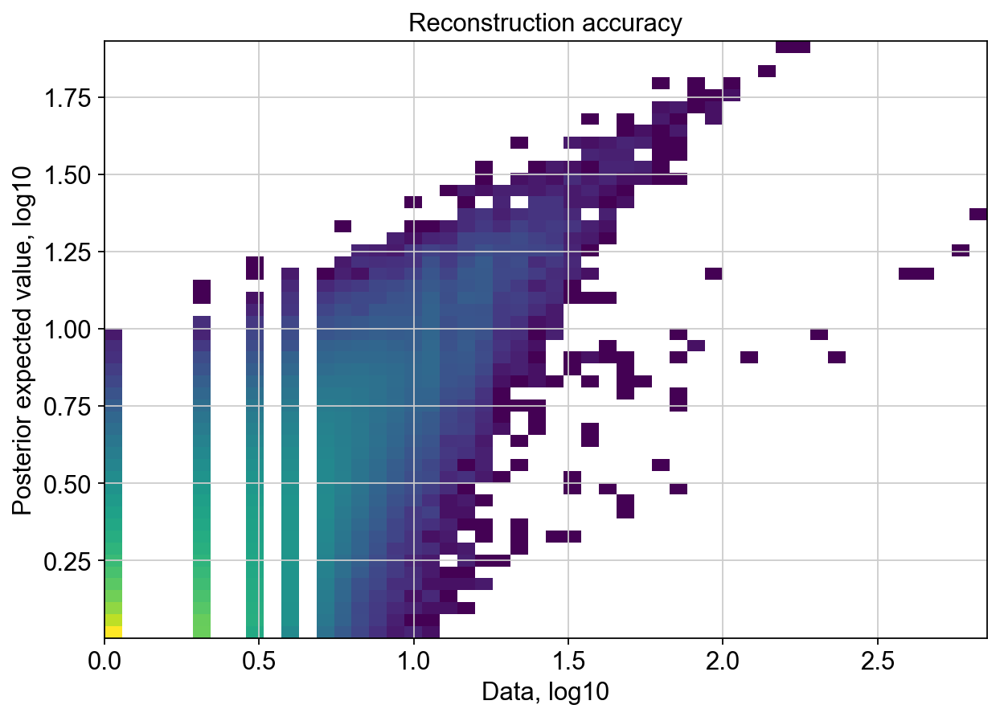

In [134]:
mod.plot_QC()

### spatial-2

In [152]:
adata_st=adata_M_brain[15000:,]

In [154]:
inf_aver=pd.read_csv(f'{ref_run_name}/inf_aver.csv',index_col=0)
# find shared genes and subset both anndata and reference signatures
intersect = np.intersect1d(adata_st.var_names, inf_aver.index)
adata_st = adata_st[:, intersect].copy()
inf_aver = inf_aver.loc[intersect, :].copy()

# prepare anndata for cell2location model
cell2location.models.Cell2location.setup_anndata(adata=adata_st, batch_key="sample")

In [155]:
adata_st

AnnData object with n_obs × n_vars = 15579 × 12196
    obs: 'sample', 'Spot_col', 'Spot_row', 'in_tissue', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_rp', 'log1p_total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', '_indices', '_scvi_batch', '_scvi_labels'
    var: 'Symbol', 'Gene_type', 'mt', 'rp', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'HE_col', 'HE_row', 'spatial', '_scvi_uuid', '_scvi_manager_uuid'
    obsm: 'spatial'
    layers: 'spliced', 'unspliced'

In [156]:
# create and train the model
mod = cell2location.models.Cell2location(
    adata_st, cell_state_df=inf_aver,
    N_cells_per_location=1,
    detection_alpha=20,
    detection_mean_per_sample=False 
)
mod.view_anndata_setup()

Anndata setup with scvi-tools version 1.0.3.

Setup via `Cell2location.setup_anndata` with arguments:

{
│   'layer': None,
│   'batch_key': 'sample',
│   'labels_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_batch          │   1   │
│         n_cells          │ 15579 │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
│         n_labels         │   1   │
│          n_vars          │ 12196 │
└──────────────────────────┴───────┘

               Data Registry                
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃    scvi-tools Location    ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │          adata.X          │
│    batch     │ adata.obs['_scvi_batch']  │
│    ind_x     │   adata.obs['_indices']   │
│    labels    │ adata.obs['_scvi_labels'] │
└──────────────┴───────────────────────────┘

                   batch State Registry                   
┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃   Source Location   ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['sample'] │   ZOO9-3   │          0          │
└─────────────────────┴────────────┴─────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

In [157]:
mod.train(max_epochs=30000,
          batch_size=None,
          use_gpu=True,
         )



GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 30000/30000: 100%|██████████| 30000/30000 [1:59:28<00:00,  4.20it/s, v_num=1, elbo_train=5.88e+7]  

`Trainer.fit` stopped: `max_epochs=30000` reached.


Epoch 30000/30000: 100%|██████████| 30000/30000 [1:59:28<00:00,  4.18it/s, v_num=1, elbo_train=5.88e+7]


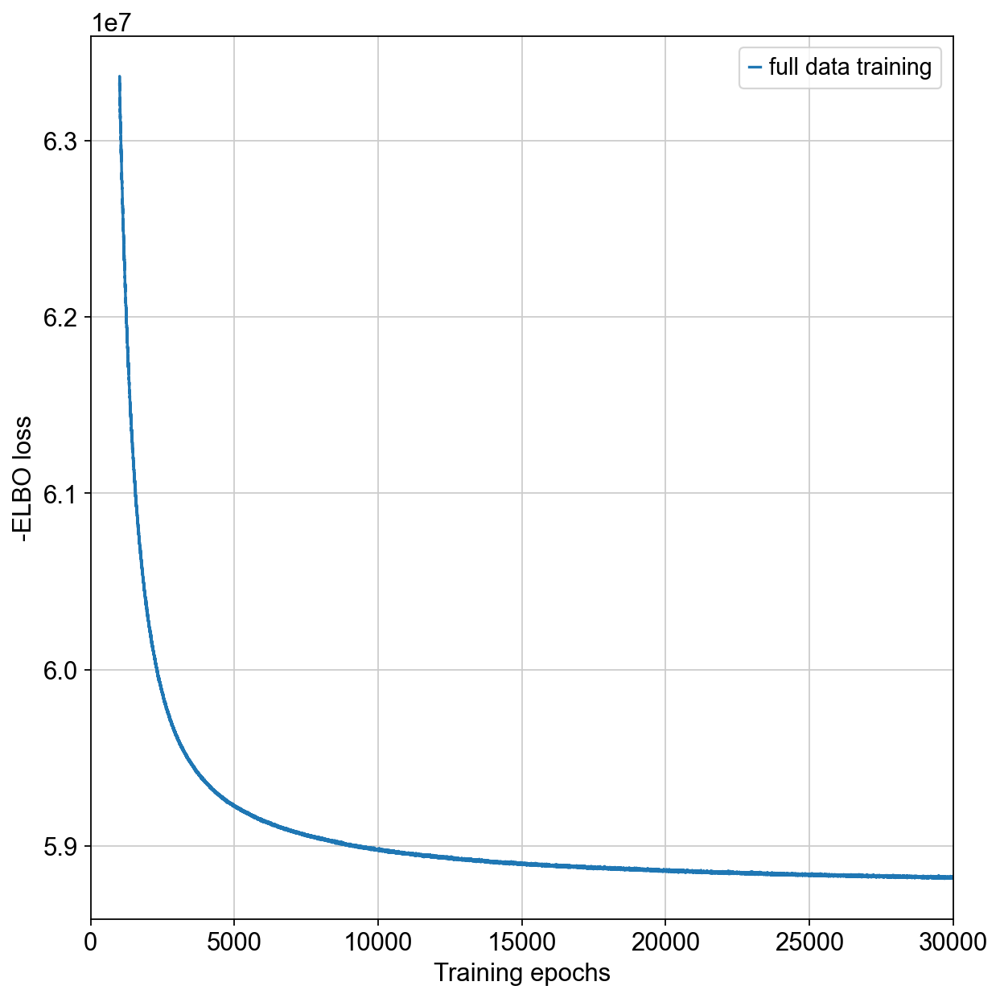

In [158]:
# plot ELBO loss history during training, removing first 100 epochs from the plot
mod.plot_history(1000)
plt.legend(labels=['full data training']);

In [159]:
# In this section, we export the estimated cell abundance (summary of the posterior distribution).
adata_st = mod.export_posterior(
    adata_st, sample_kwargs={'num_samples': 1000, 'batch_size': mod.adata.n_obs, 'use_gpu': True}
)

# Save model
mod.save(f"{run_name2}", overwrite=True)

# mod = cell2location.models.Cell2location.load(f"{run_name}", adata_vis)

# Save anndata object with results
adata_file = f"{run_name2}/sp.h5ad"
adata_st.write(adata_file)
adata_file

Sampling global variables, sample: 100%|██████████| 999/999 [00:36<00:00, 27.11it/s]


'../file/Mouse_Adult_Brain_M9/cell2location_result/cell2location_map_st2/sp.h5ad'

In [160]:
# adata_file = f"{run_name2}/sp.h5ad"
# adata_st = sc.read_h5ad(adata_file)
# mod = cell2location.models.Cell2location.load(f"{run_name2}", adata_st)

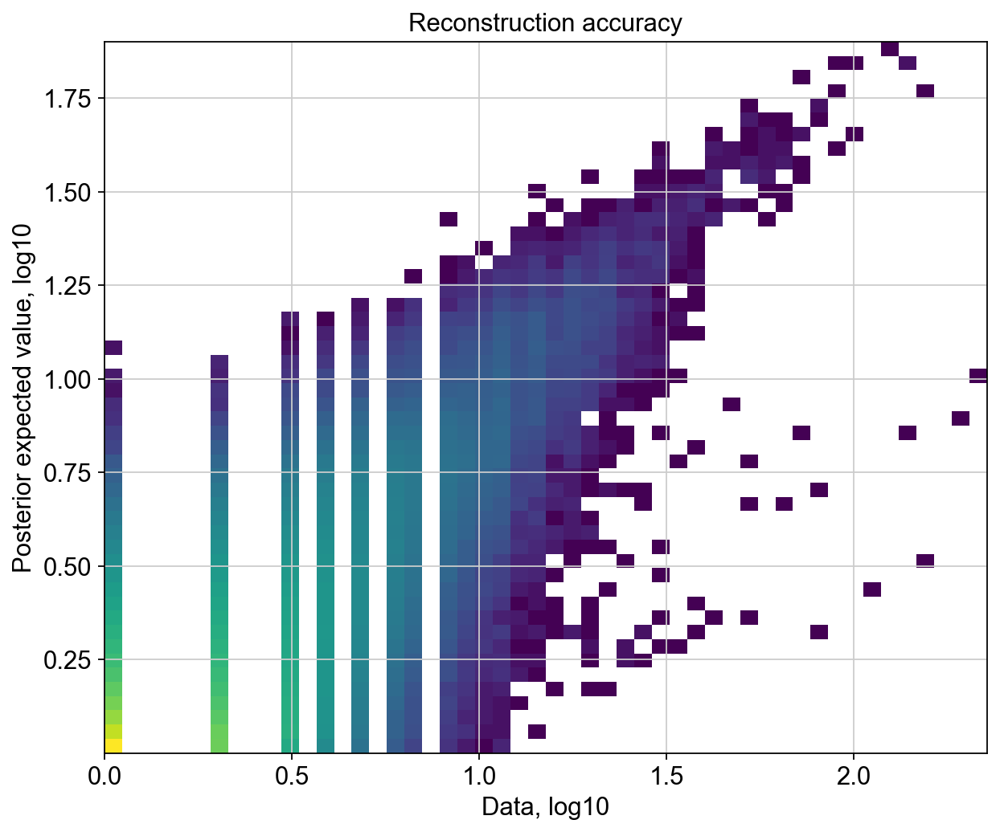

In [161]:
mod.plot_QC()

## adata-S6

In [3]:
adata_st = sc.read('/Project/MAGIC_seq/file/Mouse_Adult_Brain_M9/st_adata/adata_HIP_T3.h5ad')
adata_st.var["mt"] = adata_st.var.Symbol.str.startswith("mt-")
adata_st = adata_st[:, ~adata_st.var['mt'].values]

In [4]:
inf_aver=pd.read_csv(f'{ref_run_name}/inf_aver.csv',index_col=0)
# find shared genes and subset both anndata and reference signatures
intersect = np.intersect1d(adata_st.var_names, inf_aver.index)
adata_st = adata_st[:, intersect].copy()
inf_aver = inf_aver.loc[intersect, :].copy()

# prepare anndata for cell2location model
cell2location.models.Cell2location.setup_anndata(adata=adata_st, batch_key="sample")

No GPU/TPU found, falling back to CPU. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)


In [5]:
adata_st

AnnData object with n_obs × n_vars = 4900 × 12724
    obs: 'sample', 'reg', 'Spot_col', 'Spot_row', 'in_tissue', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_rp', 'log1p_total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', '_indices', '_scvi_batch', '_scvi_labels'
    var: 'Symbol', 'Gene_type', 'mt', 'rp', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'HE_col', 'HE_row', 'spatial', '_scvi_uuid', '_scvi_manager_uuid'
    obsm: 'spatial'
    layers: 'spliced', 'unspliced'

In [6]:
# create and train the model
mod = cell2location.models.Cell2location(
    adata_st, cell_state_df=inf_aver,
    N_cells_per_location=1,
    detection_alpha=20, 
    detection_mean_per_sample=False 
)
mod.view_anndata_setup()

Anndata setup with scvi-tools version 1.0.3.

Setup via `Cell2location.setup_anndata` with arguments:

{
│   'layer': None,
│   'batch_key': 'sample',
│   'labels_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_batch          │   1   │
│         n_cells          │ 4900  │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
│         n_labels         │   1   │
│          n_vars          │ 12724 │
└──────────────────────────┴───────┘

               Data Registry                
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃    scvi-tools Location    ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │          adata.X          │
│    batch     │ adata.obs['_scvi_batch']  │
│    ind_x     │   adata.obs['_indices']   │
│    labels    │ adata.obs['_scvi_labels'] │
└──────────────┴───────────────────────────┘

                   batch State Registry                   
┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃   Source Location   ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['sample'] │   S6_new   │          0          │
└─────────────────────┴────────────┴─────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

In [8]:
mod.train(max_epochs=30000,
          batch_size=None,
          use_gpu=True,
         )



GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 30000/30000: 100%|██████████| 30000/30000 [1:19:55<00:00,  6.21it/s, v_num=1, elbo_train=3.41e+7]

`Trainer.fit` stopped: `max_epochs=30000` reached.


Epoch 30000/30000: 100%|██████████| 30000/30000 [1:19:55<00:00,  6.26it/s, v_num=1, elbo_train=3.41e+7]


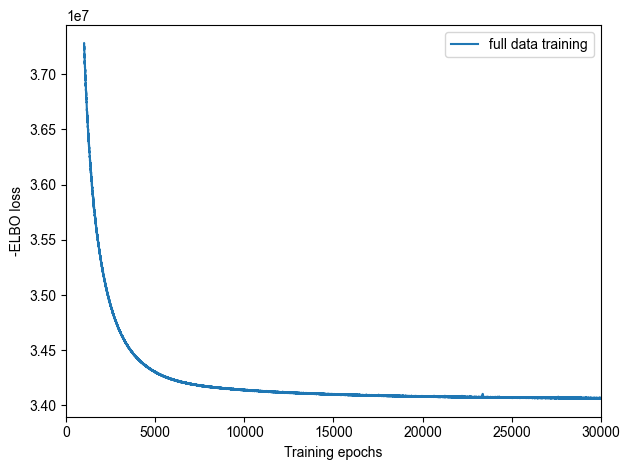

In [9]:
# plot ELBO loss history during training, removing first 100 epochs from the plot
mod.plot_history(1000)
plt.legend(labels=['full data training']);

In [10]:
# In this section, we export the estimated cell abundance (summary of the posterior distribution).
adata_st = mod.export_posterior(
    adata_st, sample_kwargs={'num_samples': 1000, 'batch_size': mod.adata.n_obs, 'use_gpu': True}
)

# Save model
mod.save(f"{run_nameS6}", overwrite=True)

# mod = cell2location.models.Cell2location.load(f"{run_name}", adata_vis)

# Save anndata object with results
adata_file = f"{run_nameS6}/sp.h5ad"
adata_st.write(adata_file)
adata_file

Sampling global variables, sample: 100%|██████████| 999/999 [00:21<00:00, 46.26it/s]


'../file/Mouse_Adult_Brain_M9/cell2location_result/cell2location_map_st_S6/sp.h5ad'

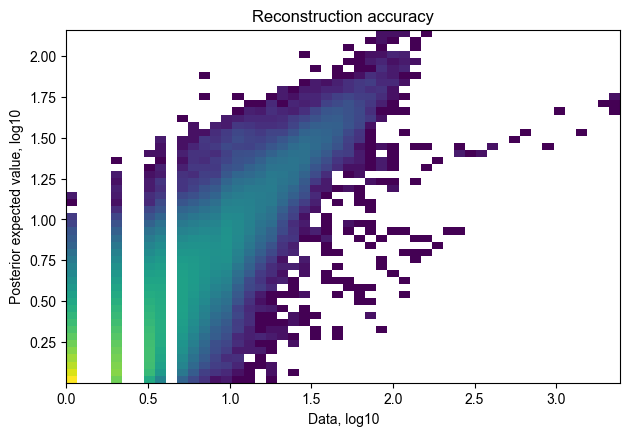

In [11]:
mod.plot_QC()

# 三、导入数据

In [235]:
adata_M_brain = sc.read('adata_brain_M9.h5ad')
adata_M_brain = adata_M_brain[adata_M_brain.obs["in_tissue"] == '1' ]
#adata_M_brain.var["mt"] = adata_M_brain.var.Symbol.str.startswith("mt-")
#adata_M_brain = adata_M_brain[:, ~adata_M_brain.var['mt'].values]
adata_M_brain.var['gene_id']=adata_M_brain.var_names
adata_M_brain.var_names=make_uniq_list(adata_M_brain.var['Symbol'])

adata_st = sc.read('adata_HIP_T3.h5ad')
#adata_st.var["mt"] = adata_st.var.Symbol.str.startswith("mt-")
#adata_st = adata_st[:, ~adata_st.var['mt'].values]
adata_st.var['gene_id']=adata_st.var_names
adata_st.var_names=make_uniq_list(adata_st.var['Symbol'])

In [236]:
adata_M_brain=interpolation_M9_70_brain(adata_M_brain)

## 3.2导入cell2location 结果

In [238]:
result_folder='../file/Mouse_Adult_Brain_M9/cell2location_result'
run_name1=f'{result_folder}/cell2location_map_st1'
run_name2=f'{result_folder}/cell2location_map_st2'
run_name6=f'{result_folder}/cell2location_map_st_S6'

adata_file = f"{run_name1}/sp.h5ad"
adata_st1 = sc.read_h5ad(adata_file)
adata_file = f"{run_name2}/sp.h5ad"
adata_st2 = sc.read_h5ad(adata_file)
adata_file = f"{run_name6}/sp.h5ad"
adata_st6 = sc.read_h5ad(adata_file)
adata_st1.obs[adata_st1.uns['mod']['factor_names']] = adata_st1.obsm['q05_cell_abundance_w_sf']
adata_st2.obs[adata_st2.uns['mod']['factor_names']] = adata_st2.obsm['q05_cell_abundance_w_sf']

adata_st6.obs[adata_st6.uns['mod']['factor_names']] = adata_st6.obsm['q05_cell_abundance_w_sf']

In [239]:
df_q05_cell_abundance_w_sf=pd.concat([adata_st1.obsm['q05_cell_abundance_w_sf'],
           adata_st2.obsm['q05_cell_abundance_w_sf']],sort=False)
df_q05_cell_abundance_w_sf.columns=adata_st1.uns['mod']['factor_names']
df_q05_cell_abundance_w_sf

,Astro_AMY,Astro_AMY_CTX,Astro_CTX,Astro_HPC,Astro_HYPO,Astro_STR,Astro_THAL_hab,Astro_THAL_lat,Astro_THAL_med,Astro_WM,...,Inh_Pvalb,Inh_Sst,Inh_Vip,Micro,Nb_1,Nb_2,OPC_1,OPC_2,Oligo_1,Oligo_2
100x1,0.043444,0.050000,0.044579,0.065276,0.040758,0.077685,0.070952,0.032827,0.039966,0.083574,...,0.135489,0.006475,0.010038,0.099362,0.042451,0.131595,0.020014,0.021951,0.033609,0.053288
100x10,0.035917,0.038595,0.029747,0.034324,0.037841,0.038414,0.078402,0.031802,0.030484,0.055078,...,0.074337,0.005412,0.011443,0.029676,0.034089,0.068635,0.013709,0.036158,0.179181,0.097776
100x100,0.047362,0.042410,0.038911,0.066574,0.080013,0.074848,0.153031,0.062362,0.056282,0.091803,...,0.053628,0.007341,0.006463,0.074252,0.048981,0.103868,0.048650,0.010033,0.448084,0.147508
100x101,0.020015,0.014727,0.011916,0.016545,0.021805,0.023855,0.043671,0.015185,0.021621,0.041869,...,0.026508,0.016438,0.004225,0.038449,0.025232,0.044312,0.005862,0.018281,1.409661,1.934704
100x102,0.045352,0.049753,0.041842,0.065783,0.057942,0.072684,0.116672,0.046479,0.047733,0.072679,...,0.015214,0.004087,0.006060,0.063366,0.031222,0.103258,0.015459,0.038129,0.854810,0.625746
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9x95,0.074205,0.069073,0.074123,0.080677,0.073618,0.088734,0.107638,0.062856,0.057349,0.105702,...,0.015398,0.075270,0.031029,0.092888,0.072205,0.146512,0.032440,0.037150,0.146552,0.149535
9x96,0.043362,0.044462,0.038233,0.042335,0.054192,0.034897,0.080523,0.036045,0.039409,0.073001,...,0.004695,0.026402,0.009768,0.059918,0.054047,0.213310,0.026023,0.018473,0.134892,0.165223
9x97,0.039456,0.033108,0.026507,0.033930,0.074670,0.031136,0.136262,0.040905,0.056027,0.077078,...,0.006772,0.005348,0.004922,0.048894,0.037373,0.110223,0.023797,0.019351,0.096304,0.206839
9x98,0.043651,0.040473,0.028826,0.045720,0.071912,0.049441,0.173541,0.039036,0.045788,0.068525,...,0.002759,0.005764,0.008210,0.132024,0.044647,0.102466,0.025688,0.013764,0.038993,0.060245


In [240]:
df_tmp=pd.DataFrame(np.zeros([len(adata_M_brain.obs.index[adata_M_brain.obs['sample']=='add']),df_q05_cell_abundance_w_sf.shape[1]]),
     columns=df_q05_cell_abundance_w_sf.columns,
     index=adata_M_brain.obs.index[adata_M_brain.obs['sample']=='add'])
df_q05_cell_abundance_w_sf=pd.concat([df_q05_cell_abundance_w_sf,df_tmp])

In [241]:
adata_M_brain.obs['Pixel_col']=list(adata_M_brain.obsm['spatial'][:,0])
adata_M_brain.obs['Pixel_row']=list(adata_M_brain.obsm['spatial'][:,1])

In [242]:
import random
dis=adata_M_brain.uns['spatial']['ZOO9-3']['scalefactors']['spot_diameter_fullres']*4

#Spot_row =71  20< Spot_col <75
for i in adata_M_brain.obs.index[(adata_M_brain.obs['Spot_row']==71) & (adata_M_brain.obs['Spot_col']>20)& (adata_M_brain.obs['Spot_col']<141)]:
    col=adata_M_brain.obs.loc[i,'Pixel_col']
    row=adata_M_brain.obs.loc[i,'Pixel_row']
    # raw_X[adata_M_brain.obs.index==i]=np.rint(np.median(raw_X[(adata.obs['sample']!='add')&(adata_M_brain.obs['Pixel_col']<(col+dis)) & (adata_M_brain.obs['Pixel_col']>(col-dis)) & 
    #           (adata_M_brain.obs['Pixel_row']<(row+dis)) & (adata_M_brain.obs['Pixel_row']>(row-dis))], axis=0)).astype(int)
    tmp_X=df_q05_cell_abundance_w_sf.loc[(adata_M_brain.obs['sample']!='add')&(adata_M_brain.obs['Pixel_col']<(col+dis)) & (adata_M_brain.obs['Pixel_col']>(col-dis)) & 
                  (adata_M_brain.obs['Pixel_row']<(row+dis)) & (adata_M_brain.obs['Pixel_row']>(row-dis))& (adata_M_brain.obs['Spot_row']!=71),:]
    if tmp_X.shape[0]>0:
        tmp_X=tmp_X.iloc[random.randint(0, tmp_X.shape[0]-1),:]
        df_q05_cell_abundance_w_sf.loc[i,:]=tmp_X
    else:
        tmp_X=df_q05_cell_abundance_w_sf.loc[(adata_M_brain.obs['sample']!='add')&(adata_M_brain.obs['Pixel_col']<(col+dis*2)) & (adata_M_brain.obs['Pixel_col']>(col-dis*2)) & 
                      (adata_M_brain.obs['Pixel_row']<(row+dis*2)) & (adata_M_brain.obs['Pixel_row']>(row-dis*2)),:]
        tmp_X=tmp_X.iloc[random.randint(0, tmp_X.shape[0]-1),:]
        df_q05_cell_abundance_w_sf.loc[i,:]=tmp_X    
#Spot_row =71  20< Spot_col <75
for i in adata_M_brain.obs.index[(adata_M_brain.obs['Spot_row']==140) & (adata_M_brain.obs['Spot_col']>70)& (adata_M_brain.obs['Spot_col']<210)]:
    col=adata_M_brain.obs.loc[i,'Pixel_col']
    row=adata_M_brain.obs.loc[i,'Pixel_row']
    # raw_X[adata_M_brain.obs.index==i]=np.rint(np.median(raw_X[(adata.obs['sample']!='add')&(adata_M_brain.obs['Pixel_col']<(col+dis)) & (adata_M_brain.obs['Pixel_col']>(col-dis)) & 
    #           (adata_M_brain.obs['Pixel_row']<(row+dis)) & (adata_M_brain.obs['Pixel_row']>(row-dis))], axis=0)).astype(int)
    tmp_X=df_q05_cell_abundance_w_sf.loc[(adata_M_brain.obs['sample']!='add')&(adata_M_brain.obs['Pixel_col']<(col+dis)) & (adata_M_brain.obs['Pixel_col']>(col-dis)) & 
                  (adata_M_brain.obs['Pixel_row']<(row+dis)) & (adata_M_brain.obs['Pixel_row']>(row-dis))& (adata_M_brain.obs['Spot_row']!=140),:]
    if tmp_X.shape[0]>0:
        tmp_X=tmp_X.iloc[random.randint(0, tmp_X.shape[0]-1),:]
        df_q05_cell_abundance_w_sf.loc[i,:]=tmp_X
    else:
        tmp_X=df_q05_cell_abundance_w_sf.loc[(adata_M_brain.obs['sample']!='add')&(adata_M_brain.obs['Pixel_col']<(col+dis*2)) & (adata_M_brain.obs['Pixel_col']>(col-dis*2)) & 
                      (adata_M_brain.obs['Pixel_row']<(row+dis*2)) & (adata_M_brain.obs['Pixel_row']>(row-dis*2)),:]
        tmp_X=tmp_X.iloc[random.randint(0, tmp_X.shape[0]-1),:]
        df_q05_cell_abundance_w_sf.loc[i,:]=tmp_X  
#Spot_row =141 Spot_col <75
for i in adata_M_brain.obs.index[adata_M_brain.obs['Spot_row']==141]:
    col=adata_M_brain.obs.loc[i,'Pixel_col']
    row=adata_M_brain.obs.loc[i,'Pixel_row']
    # raw_X[adata_M_brain.obs.index==i]=np.rint(np.median(raw_X[(adata.obs['sample']!='add')&(adata_M_brain.obs['Pixel_col']<(col+dis)) & (adata_M_brain.obs['Pixel_col']>(col-dis)) & 
    #           (adata_M_brain.obs['Pixel_row']<(row+dis)) & (adata_M_brain.obs['Pixel_row']>(row-dis))], axis=0)).astype(int)
    tmp_X=df_q05_cell_abundance_w_sf.loc[(adata_M_brain.obs['sample']!='add')&(adata_M_brain.obs['Pixel_col']<(col+dis)) & (adata_M_brain.obs['Pixel_col']>(col-dis)) & 
                  (adata_M_brain.obs['Pixel_row']<(row+dis)) & (adata_M_brain.obs['Pixel_row']>(row-dis))& (adata_M_brain.obs['Spot_row']!=141),:]
    if tmp_X.shape[0]>0:
        tmp_X=tmp_X.iloc[random.randint(0, tmp_X.shape[0]-1),:]
        df_q05_cell_abundance_w_sf.loc[i,:]=tmp_X
    else:
        tmp_X=df_q05_cell_abundance_w_sf.loc[(adata_M_brain.obs['sample']!='add')&(adata_M_brain.obs['Pixel_col']<(col+dis*2)) & (adata_M_brain.obs['Pixel_col']>(col-dis*2)) & 
                      (adata_M_brain.obs['Pixel_row']<(row+dis*2)) & (adata_M_brain.obs['Pixel_row']>(row-dis*2)),:]
        tmp_X=tmp_X.iloc[random.randint(0, tmp_X.shape[0]-1),:]
        df_q05_cell_abundance_w_sf.loc[i,:]=tmp_X    
#Spot_row =141 Spot_col <75
for i in adata_M_brain.obs.index[adata_M_brain.obs['Spot_row']==162]:
    col=adata_M_brain.obs.loc[i,'Pixel_col']
    row=adata_M_brain.obs.loc[i,'Pixel_row']
    # raw_X[adata_M_brain.obs.index==i]=np.rint(np.median(raw_X[(adata.obs['sample']!='add')&(adata_M_brain.obs['Pixel_col']<(col+dis)) & (adata_M_brain.obs['Pixel_col']>(col-dis)) & 
    #           (adata_M_brain.obs['Pixel_row']<(row+dis)) & (adata_M_brain.obs['Pixel_row']>(row-dis))], axis=0)).astype(int)
    tmp_X=df_q05_cell_abundance_w_sf.loc[(adata_M_brain.obs['sample']!='add')&(adata_M_brain.obs['Pixel_col']<(col+dis)) & (adata_M_brain.obs['Pixel_col']>(col-dis)) & 
                  (adata_M_brain.obs['Pixel_row']<(row+dis)) & (adata_M_brain.obs['Pixel_row']>(row-dis))& (adata_M_brain.obs['Spot_row']!=162),:]
    if tmp_X.shape[0]>0:
        tmp_X=tmp_X.iloc[random.randint(0, tmp_X.shape[0]-1),:]
        df_q05_cell_abundance_w_sf.loc[i,:]=tmp_X
    else:
        tmp_X=df_q05_cell_abundance_w_sf.loc[(adata_M_brain.obs['sample']!='add')&(adata_M_brain.obs['Pixel_col']<(col+dis*2)) & (adata_M_brain.obs['Pixel_col']>(col-dis*2)) & 
                      (adata_M_brain.obs['Pixel_row']<(row+dis*2)) & (adata_M_brain.obs['Pixel_row']>(row-dis*2)),:]
        tmp_X=tmp_X.iloc[random.randint(0, tmp_X.shape[0]-1),:]
        df_q05_cell_abundance_w_sf.loc[i,:]=tmp_X   
for i in adata_M_brain.obs.index[adata_M_brain.obs['Spot_col']==21]:
    col=adata_M_brain.obs.loc[i,'Pixel_col']
    row=adata_M_brain.obs.loc[i,'Pixel_row']
    # raw_X[adata_M_brain.obs.index==i]=np.rint(np.median(raw_X[(adata.obs['sample']!='add')&(adata_M_brain.obs['Pixel_col']<(col+dis)) & (adata_M_brain.obs['Pixel_col']>(col-dis)) & 
    #           (adata_M_brain.obs['Pixel_row']<(row+dis)) & (adata_M_brain.obs['Pixel_row']>(row-dis))], axis=0)).astype(int)
    tmp_X=df_q05_cell_abundance_w_sf.loc[(adata_M_brain.obs['sample']!='add')&(adata_M_brain.obs['Pixel_col']<(col+dis)) & (adata_M_brain.obs['Pixel_col']>(col-dis)) & 
                  (adata_M_brain.obs['Pixel_row']<(row+dis)) & (adata_M_brain.obs['Pixel_row']>(row-dis))& (adata_M_brain.obs['Spot_col']!=21),:]
    if tmp_X.shape[0]>0:
        tmp_X=tmp_X.iloc[random.randint(0, tmp_X.shape[0]-1),:]
        df_q05_cell_abundance_w_sf.loc[i,:]=tmp_X
    else:
        tmp_X=df_q05_cell_abundance_w_sf.loc[(adata_M_brain.obs['sample']!='add')&(adata_M_brain.obs['Pixel_col']<(col+dis*2)) & (adata_M_brain.obs['Pixel_col']>(col-dis*2)) & 
                      (adata_M_brain.obs['Pixel_row']<(row+dis*2)) & (adata_M_brain.obs['Pixel_row']>(row-dis*2)),:]
        tmp_X=tmp_X.iloc[random.randint(0, tmp_X.shape[0]-1),:]
        df_q05_cell_abundance_w_sf.loc[i,:]=tmp_X 
        
for i in adata_M_brain.obs.index[adata_M_brain.obs['Spot_col']==30]:
    col=adata_M_brain.obs.loc[i,'Pixel_col']
    row=adata_M_brain.obs.loc[i,'Pixel_row']
    # raw_X[adata_M_brain.obs.index==i]=np.rint(np.median(raw_X[(adata.obs['sample']!='add')&(adata_M_brain.obs['Pixel_col']<(col+dis)) & (adata_M_brain.obs['Pixel_col']>(col-dis)) & 
    #           (adata_M_brain.obs['Pixel_row']<(row+dis)) & (adata_M_brain.obs['Pixel_row']>(row-dis))], axis=0)).astype(int)
    tmp_X=df_q05_cell_abundance_w_sf.loc[(adata_M_brain.obs['sample']!='add')&(adata_M_brain.obs['Pixel_col']<(col+dis)) & (adata_M_brain.obs['Pixel_col']>(col-dis)) & 
                  (adata_M_brain.obs['Pixel_row']<(row+dis)) & (adata_M_brain.obs['Pixel_row']>(row-dis))& (adata_M_brain.obs['Spot_col']!=30),:]
    if tmp_X.shape[0]>0:
        tmp_X=tmp_X.iloc[random.randint(0, tmp_X.shape[0]-1),:]
        df_q05_cell_abundance_w_sf.loc[i,:]=tmp_X
    else:
        tmp_X=df_q05_cell_abundance_w_sf.loc[(adata_M_brain.obs['sample']!='add')&(adata_M_brain.obs['Pixel_col']<(col+dis*2)) & (adata_M_brain.obs['Pixel_col']>(col-dis*2)) & 
                      (adata_M_brain.obs['Pixel_row']<(row+dis*2)) & (adata_M_brain.obs['Pixel_row']>(row-dis*2)),:]
        tmp_X=tmp_X.iloc[random.randint(0, tmp_X.shape[0]-1),:]
        df_q05_cell_abundance_w_sf.loc[i,:]=tmp_X   
for i in adata_M_brain.obs.index[adata_M_brain.obs['Spot_col']==60]:
    col=adata_M_brain.obs.loc[i,'Pixel_col']
    row=adata_M_brain.obs.loc[i,'Pixel_row']
    # raw_X[adata_M_brain.obs.index==i]=np.rint(np.median(raw_X[(adata.obs['sample']!='add')&(adata_M_brain.obs['Pixel_col']<(col+dis)) & (adata_M_brain.obs['Pixel_col']>(col-dis)) & 
    #           (adata_M_brain.obs['Pixel_row']<(row+dis)) & (adata_M_brain.obs['Pixel_row']>(row-dis))], axis=0)).astype(int)
    tmp_X=df_q05_cell_abundance_w_sf.loc[(adata_M_brain.obs['sample']!='add')&(adata_M_brain.obs['Pixel_col']<(col+dis)) & (adata_M_brain.obs['Pixel_col']>(col-dis)) & 
                  (adata_M_brain.obs['Pixel_row']<(row+dis)) & (adata_M_brain.obs['Pixel_row']>(row-dis))& (adata_M_brain.obs['Spot_col']!=60),:]
    if tmp_X.shape[0]>0:
        tmp_X=tmp_X.iloc[random.randint(0, tmp_X.shape[0]-1),:]
        df_q05_cell_abundance_w_sf.loc[i,:]=tmp_X
    else:
        tmp_X=df_q05_cell_abundance_w_sf.loc[(adata_M_brain.obs['sample']!='add')&(adata_M_brain.obs['Pixel_col']<(col+dis*2)) & (adata_M_brain.obs['Pixel_col']>(col-dis*2)) & 
                      (adata_M_brain.obs['Pixel_row']<(row+dis*2)) & (adata_M_brain.obs['Pixel_row']>(row-dis*2)),:]
        tmp_X=tmp_X.iloc[random.randint(0, tmp_X.shape[0]-1),:]
        df_q05_cell_abundance_w_sf.loc[i,:]=tmp_X    
for i in adata_M_brain.obs.index[adata_M_brain.obs['sample']=='add']:
    col=adata_M_brain.obs.loc[i,'Pixel_col']
    row=adata_M_brain.obs.loc[i,'Pixel_row']
    # raw_X[adata_M_brain.obs.index==i]=np.rint(np.median(raw_X[(adata.obs['sample']!='add')&(adata_M_brain.obs['Pixel_col']<(col+dis)) & (adata_M_brain.obs['Pixel_col']>(col-dis)) & 
    #           (adata_M_brain.obs['Pixel_row']<(row+dis)) & (adata_M_brain.obs['Pixel_row']>(row-dis))], axis=0)).astype(int)
    tmp_X=df_q05_cell_abundance_w_sf.loc[(adata_M_brain.obs['sample']!='add')&(adata_M_brain.obs['Pixel_col']<(col+dis)) & (adata_M_brain.obs['Pixel_col']>(col-dis)) & 
                  (adata_M_brain.obs['Pixel_row']<(row+dis)) & (adata_M_brain.obs['Pixel_row']>(row-dis)),:]
    if tmp_X.shape[0]>0:
        tmp_X=tmp_X.iloc[random.randint(0, tmp_X.shape[0]-1),:]
        df_q05_cell_abundance_w_sf.loc[i,:]=tmp_X
    else:
        tmp_X=df_q05_cell_abundance_w_sf.loc[(adata_M_brain.obs['sample']!='add')&(adata_M_brain.obs['Pixel_col']<(col+dis*2)) & (adata_M_brain.obs['Pixel_col']>(col-dis*2)) & 
                      (adata_M_brain.obs['Pixel_row']<(row+dis*2)) & (adata_M_brain.obs['Pixel_row']>(row-dis*2)),:]
        tmp_X=tmp_X.iloc[random.randint(0, tmp_X.shape[0]-1),:]
        df_q05_cell_abundance_w_sf.loc[i,:]=tmp_X

In [243]:
adata_M_brain.obs[adata_st1.uns['mod']['factor_names']] = df_q05_cell_abundance_w_sf[adata_st1.uns['mod']['factor_names']]

In [244]:
df_q05_cell_abundance_w_sf6=adata_st6.obsm['q05_cell_abundance_w_sf']
adata_st.obs[adata_st6.uns['mod']['factor_names']] = df_q05_cell_abundance_w_sf6

## 查看细胞类型比例

In [245]:
x=0.5
p1=sum((df_q05_cell_abundance_w_sf>x).sum(1)==1)/sum((df_q05_cell_abundance_w_sf>x).sum(1)>=1)
p2=sum((df_q05_cell_abundance_w_sf>x).sum(1)==2)/sum((df_q05_cell_abundance_w_sf>x).sum(1)>=1)
p3=sum((df_q05_cell_abundance_w_sf>x).sum(1)>=3)/sum((df_q05_cell_abundance_w_sf>x).sum(1)>=1)
#p4=sum((df_q05_cell_abundance_w_sf>1).sum(1)==4)/sum((df_q05_cell_abundance_w_sf>1).sum(1)>=1)
#p5=sum((df_q05_cell_abundance_w_sf>1).sum(1)==5)/sum((df_q05_cell_abundance_w_sf>1).sum(1)>=1)

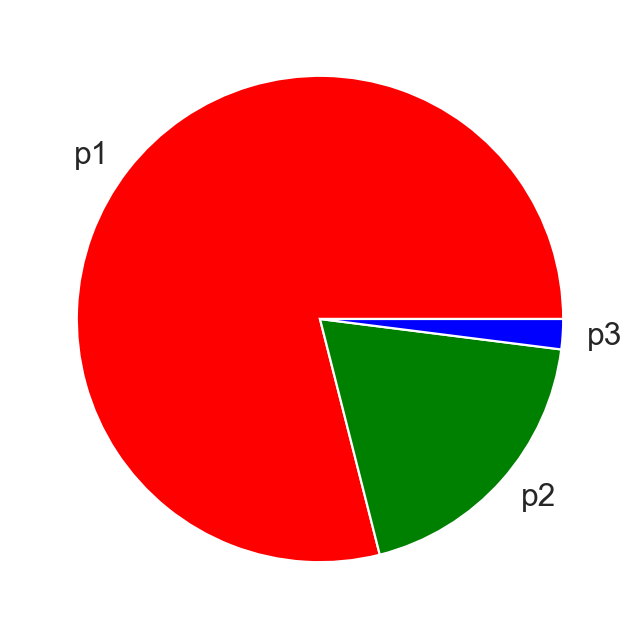

In [246]:
# create data
plt.figure(figsize=(5,5))
names = ['p1','p2','p3']
size = [p1,p2,p3]
plt.pie(size, labels=names,colors=[ 'red', 'green', 'blue'])
#plt.savefig('D:/Task/Zhao_lab/Zhujunjie/file/Fig/Fig4/Fig4-cell-pie.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')
plt.show()

meta NOT subset; don't know how to subset; dropped


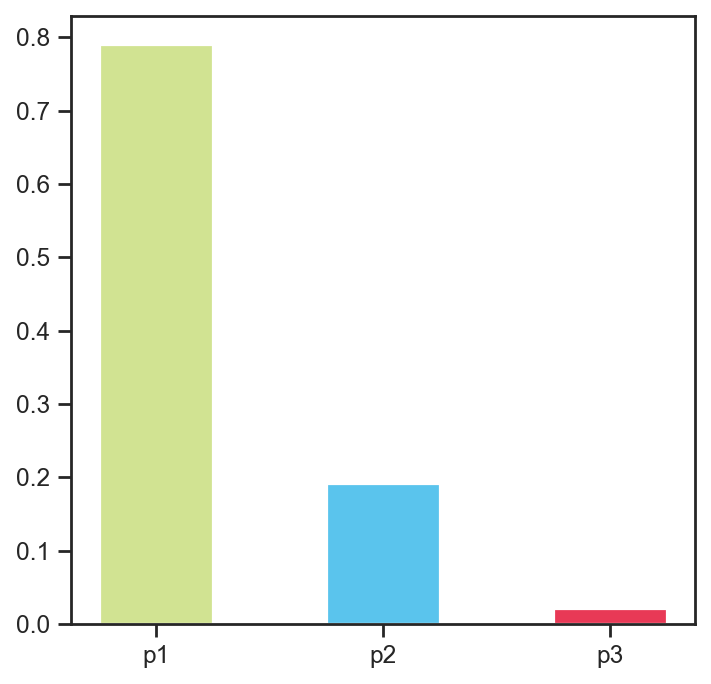

In [247]:
# libraries
import numpy as np
import matplotlib.pyplot as plt
sns.set(style='ticks')
plt.figure(figsize=(5,5))
# create a dataset
height = [p1,p2,p3]
bars = ['p1','p2','p3']
x_pos = np.arange(len(bars))

# Create bars with different colors
plt.bar(x_pos, height, color=[ '#d1e392', '#5ac4ed', '#e83956', 'cyan'],width=0.5)

# Create names on the x-axis
plt.xticks(x_pos, bars)
plt.savefig('../Figure/Figure2/FigureS6-cell-percent.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')
#Show graph
plt.show()

In [248]:
height

[0.7895271741760634, 0.19048540870154382, 0.019987417122392683]

In [249]:
p1=sum((df_q05_cell_abundance_w_sf>1).sum(1)==1)/sum((df_q05_cell_abundance_w_sf>1).sum(1)>=1)

In [250]:
df_cell_count=pd.DataFrame((df_q05_cell_abundance_w_sf>x).sum(0)[df_q05_cell_abundance_w_sf.columns[(df_q05_cell_abundance_w_sf>x).sum(0)>420]])
df_cell_count.loc['other',0]=(df_q05_cell_abundance_w_sf>x).sum(0)[df_q05_cell_abundance_w_sf.columns[(df_q05_cell_abundance_w_sf>x).sum(0)<=420]].sum()
df_cell_count.index=[i.replace('q05cell_abundance_w_sf_','') for i in df_cell_count.index ]
df_cell_count.columns=['count']

In [251]:
df_cell_count.shape

(15, 1)

In [254]:

cmaps = ['#e0e0e0','#10976f',
    '#cac43d',
    '#ec7c7f',
    '#865123',
    '#ffbe2c',
    '#67c1dd',
    '#f0e442',
    '#b71e75',
    '#1681ec',
    '#009e73',
    '#7cc07c',
    '#a81e2b',
    '#56b4e9','#57139f']#'#57139f'

In [255]:
df_cell_count=df_cell_count.sort_values('count',ascending=False)
df_cell_count['color']=cmaps
df_cell_count['cell_type']=df_cell_count.index

meta NOT subset; don't know how to subset; dropped


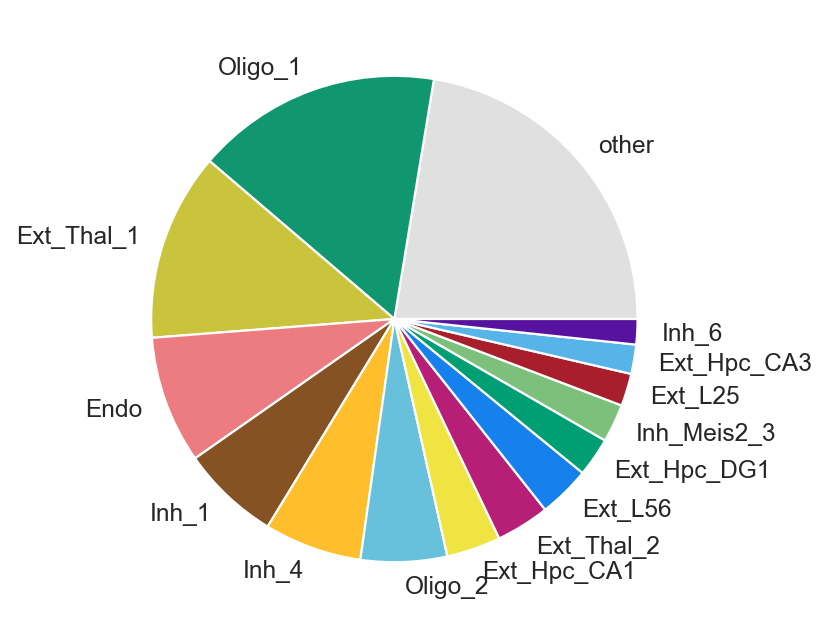

In [256]:
# create data
plt.figure(figsize=(5,5))
names = list(df_cell_count.index)
size = list(df_cell_count['count'])
plt.pie(size, labels=names,colors=list(df_cell_count['color']))
plt.savefig('../Figure/Figure2/FigureS6-celltype-percent.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')
plt.show()

In [257]:
df_cell_count=df_cell_count.sort_values(['count'],ascending =False)
df_cell_count

,count,color,cell_type
other,5697.0,#e0e0e0,other
Oligo_1,4158.0,#10976f,Oligo_1
Ext_Thal_1,3177.0,#cac43d,Ext_Thal_1
Endo,2157.0,#ec7c7f,Endo
Inh_1,1670.0,#865123,Inh_1
Inh_4,1650.0,#ffbe2c,Inh_4
Oligo_2,1459.0,#67c1dd,Oligo_2
Ext_Hpc_CA1,915.0,#f0e442,Ext_Hpc_CA1
Ext_Thal_2,904.0,#b71e75,Ext_Thal_2
Ext_L56,875.0,#1681ec,Ext_L56


In [ ]:
cell_type_list=list(adata_st1.uns['mod']['factor_names'])
cell_type_list

In [261]:
#df_cell_count=pd.DataFrame((df_q05_cell_abundance_w_sf>1).sum(0)[df_q05_cell_abundance_w_sf.columns[(df_q05_cell_abundance_w_sf>1).sum(0)>0]])
df_cell_count=pd.DataFrame((df_q05_cell_abundance_w_sf>x).sum(0))
df_cell_count.index=[i.replace('q05cell_abundance_w_sf_','') for i in df_cell_count.index ]
df_cell_count.columns=['count']
df_cell_count=df_cell_count.sort_values(['count'],ascending =False)

In [369]:
#df_cell_count=pd.DataFrame((df_q05_cell_abundance_w_sf6>1).sum(0)[df_q05_cell_abundance_w_sf6.columns[(df_q05_cell_abundance_w_sf6>1).sum(0)>0]])
df_cell_count6=pd.DataFrame((df_q05_cell_abundance_w_sf6>1).sum(0))
df_cell_count6.index=[i.replace('q05cell_abundance_w_sf_','') for i in df_cell_count6.index ]
df_cell_count6.columns=['count']
df_cell_count6=df_cell_count6.sort_values(['count'],ascending =False)

## 查看细胞类型分布

In [ ]:
from plot_spatial_all import get_rgb_function,plot_spatial_general,plot_spatial_all,rgb_to_ryb,ryb_to_rgb,hex2rgb_3
from plot_spatial import get_rgb_function,plot_spatial_general,plot_spatial,rgb_to_ryb,ryb_to_rgb

clust_labels=list(df_cell_count.index[df_cell_count['count']>5])

with mpl.rc_context({'figure.figsize': (10, 10)}):
    fig = plot_spatial_all(
        adata=adata_M_brain,
        # labels to show on a plot
        color=clust_labels, labels=clust_labels,
        show_img=False,
        # 'fast' (white background) or 'dark_background'
       style='fast',
        # limit color scale at 99.2% quantile of cell abundance
        min_color_quantile=0.50,
        max_color_quantile=0.998,
        # size of locations (adjust depending on figure size)
        circle_diameter=1,
        colorbar_position='right'
    )

meta NOT subset; don't know how to subset; dropped


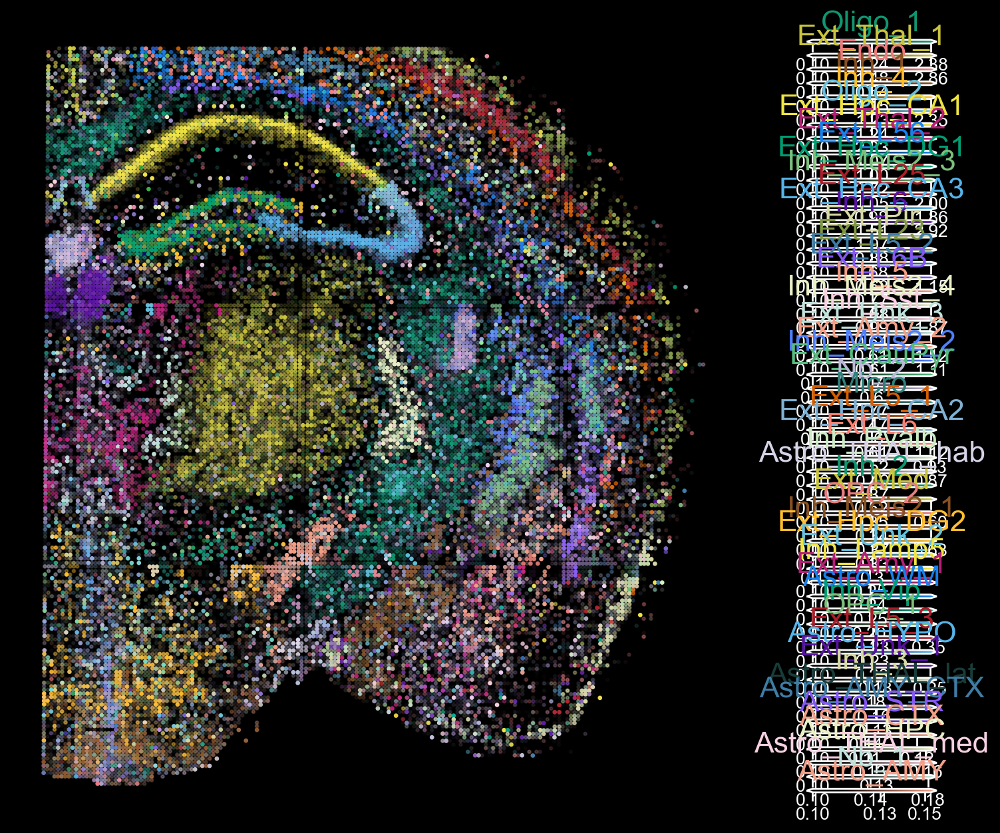

In [264]:
clust_labels=list(df_cell_count.index[df_cell_count['count']>=0])
clust_col = ['' + str(i) for i in clust_labels] # in case column names differ from labels


with mpl.rc_context({'figure.figsize': (12, 10)}):
    fig = plot_spatial_all(
        adata=adata_M_brain,
        # labels to show on a plot
        color=clust_col, labels=clust_labels,
        show_img=False,
        # 'fast' (white background) or 'dark_background'
       style='dark_background',
        # limit color scale at 99.2% quantile of cell abundance
        min_color_quantile=0.10,
        max_color_quantile=0.998,
        # size of locations (adjust depending on figure size)
        circle_diameter=2,
        colorbar_position='right'
    )
plt.savefig('../Figure/Figure2/Figure2-cell2location-all.pdf', dpi = 600, transparent=True, format = 'pdf', bbox_inches='tight')

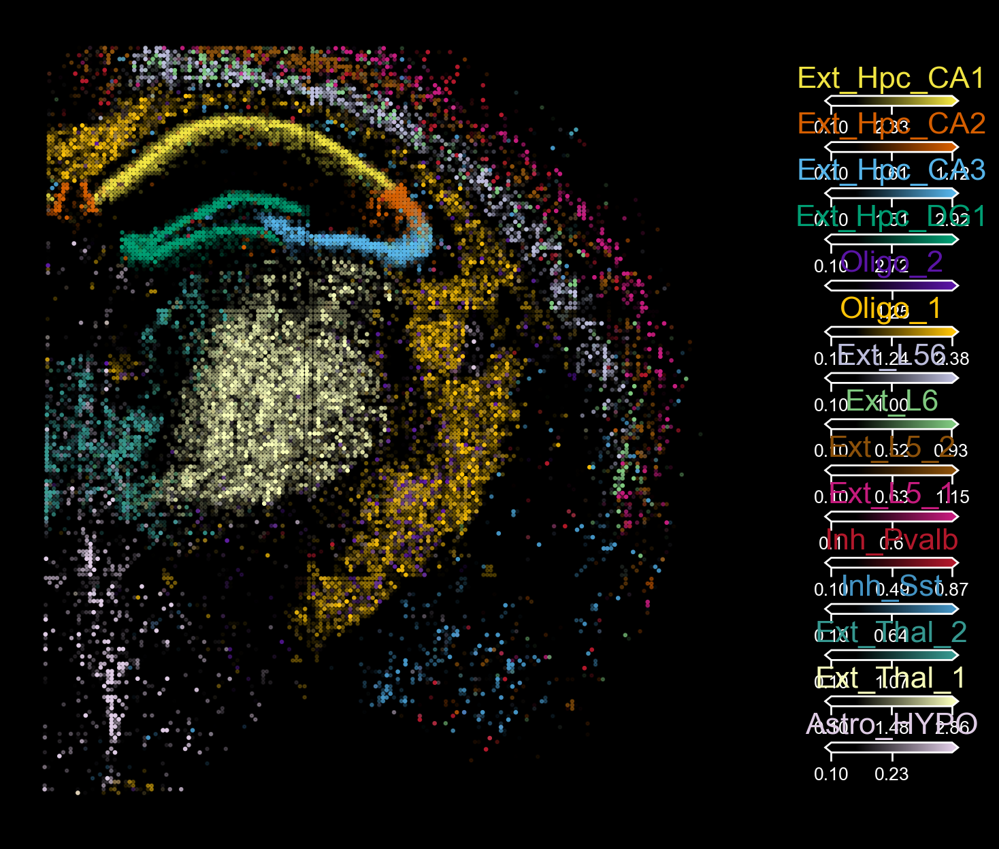

In [265]:
clust_labels = ["Ext_Hpc_CA1", "Ext_Hpc_CA2","Ext_Hpc_CA3","Ext_Hpc_DG1","Oligo_2",'Oligo_1',
                'Ext_L56','Ext_L6','Ext_L5_2','Ext_L5_1','Inh_Pvalb','Inh_Sst','Ext_Thal_2','Ext_Thal_1','Astro_HYPO']

clust_col = ['' + str(i) for i in clust_labels] # in case column names differ from labels


with mpl.rc_context({'figure.figsize': (12, 10)}):
    fig = plot_spatial(
        adata=adata_M_brain,
        # labels to show on a plot
        color=clust_col, labels=clust_labels,
        show_img=False,
        # 'fast' (white background) or 'dark_background'
       style='dark_background',
        # limit color scale at 99.2% quantile of cell abundance
        min_color_quantile=0.5,
        max_color_quantile=0.998,
        # size of locations (adjust depending on figure size)
        circle_diameter=2,
        colorbar_position='right'
    )


meta NOT subset; don't know how to subset; dropped


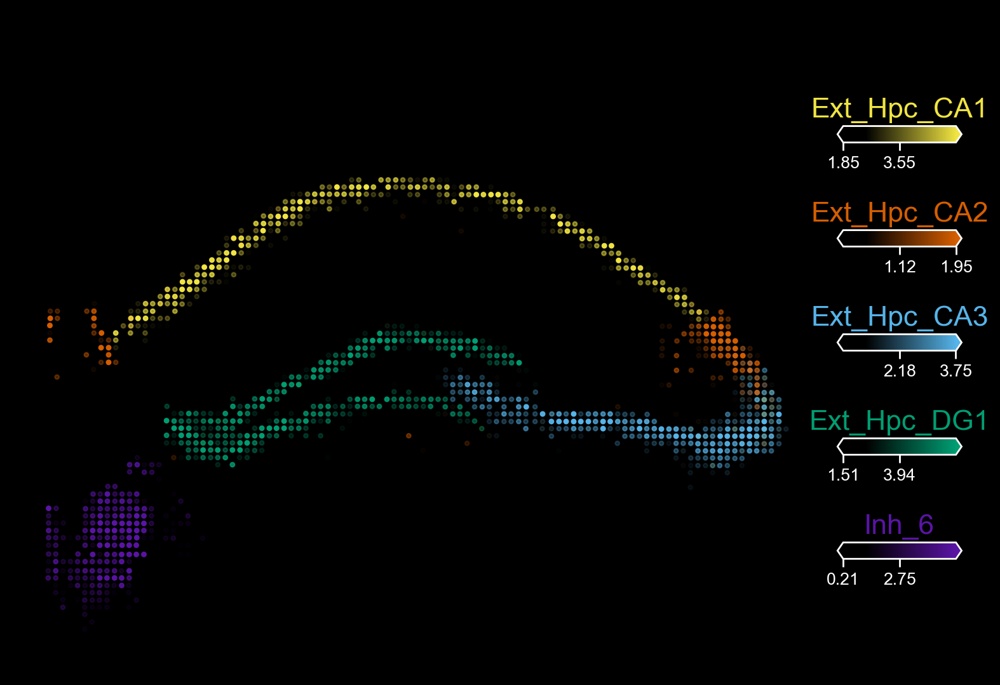

In [266]:
# Now we use cell2location plotter that allows showing multiple cell types in one panel
#from cell2location.plt import plot_spatial
from plot_spatial_all import get_rgb_function,plot_spatial_general,plot_spatial_all,rgb_to_ryb,ryb_to_rgb
# select up to 6 clusters
clust_labels = ['Ext_Hpc_CA1', 'Ext_Hpc_CA2', 'Ext_Hpc_CA3','Ext_Hpc_DG1','Inh_6']
#clust_labels=[i.replace('q05cell_abundance_w_sf_','') for i in df_q05_cell_abundance_w_sf.columns[(df_q05_cell_abundance_w_sf>1).sum(0)>200]]
clust_col = ['' + str(i) for i in clust_labels] # in case column names differ from labels


adata_reg1_Hip=adata_M_brain[[2500>i>700 for i in adata_M_brain.obs['Pixel_col']]]
adata_reg1_Hip=adata_reg1_Hip[ [2200>i>600 for i in adata_reg1_Hip.obs['Pixel_row']]]


with mpl.rc_context({'figure.figsize': (12, 10)}):
    fig = plot_spatial(
        adata=adata_reg1_Hip,
        # labels to show on a plot
        color=clust_col, labels=clust_labels,
        show_img=False,
        # 'fast' (white background) or 'dark_background'
       style='dark_background',
        # limit color scale at 99.2% quantile of cell abundance
        min_color_quantile=0.95,
        max_color_quantile=0.998,
        # size of locations (adjust depending on figure size)
        circle_diameter=3,
        colorbar_position='right'
    )
plt.savefig('../Figure/Figure2/Figure2-cell2location-M3-Hip.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')

meta NOT subset; don't know how to subset; dropped


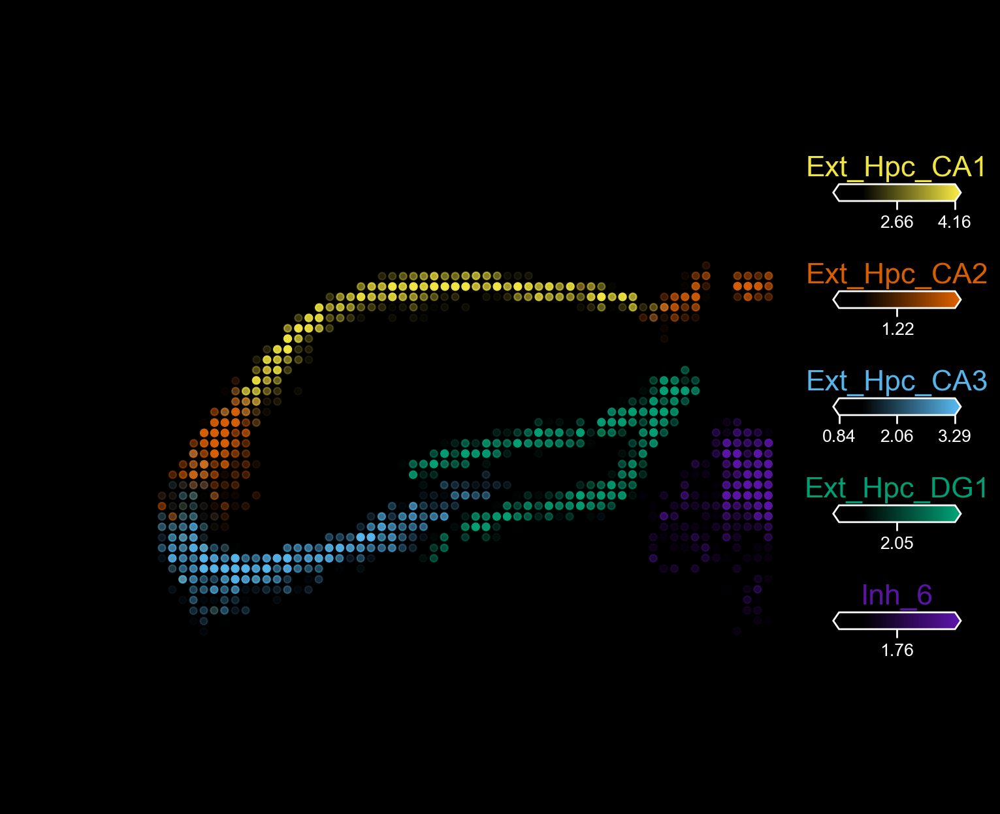

In [267]:
# Now we use cell2location plotter that allows showing multiple cell types in one panel
#from cell2location.plt import plot_spatial
from plot_spatial import get_rgb_function,plot_spatial_general,plot_spatial,rgb_to_ryb,ryb_to_rgb
# select up to 6 clusters
clust_labels = ['Ext_Hpc_CA1', 'Ext_Hpc_CA2', 'Ext_Hpc_CA3','Ext_Hpc_DG1','Inh_6']
#clust_labels=[i.replace('q05cell_abundance_w_sf_','') for i in df_q05_cell_abundance_w_sf.columns[(df_q05_cell_abundance_w_sf>1).sum(0)>200]]
clust_col = ['' + str(i) for i in clust_labels] # in case column names differ from labels

with mpl.rc_context({'figure.figsize': (12, 10)}):
    fig = plot_spatial(
        adata=adata_st,
        # labels to show on a plot
        color=clust_col, labels=clust_labels,
        show_img=False,
        # 'fast' (white background) or 'dark_background'
       style='dark_background',
        # limit color scale at 99.2% quantile of cell abundance
        min_color_quantile=0.95,
        max_color_quantile=0.998,
        # size of locations (adjust depending on figure size)
        circle_diameter=5,
        colorbar_position='right'
    )
plt.savefig('../Figure/Figure2/Figure2-cell2location-S6-Hip.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')

In [270]:
def adata_filter_norm_process(adata,min_cells_num=10,min_genes_num=10,in_tissue=True):  
    adata.uns['crop_coord']= [min(adata.obsm['spatial'][:,0]), max(adata.obsm['spatial'][:,0]),
           min(adata.obsm['spatial'][:,1]), max(adata.obsm['spatial'][:,1])]
    if in_tissue:
        adata = adata[adata.obs["in_tissue"] == '1' ]
    sc.pp.filter_genes(adata, min_cells=min_cells_num)
    sc.pp.filter_cells(adata, min_genes=min_genes_num)
    adata.layers['raw'] = adata.X.copy()
    sc.pp.normalize_total(adata,target_sum=1e4)
    adata.raw = adata.copy()
    sc.pp.log1p(adata)
    sc.pp.highly_variable_genes(adata,n_top_genes=18000) 
    sc.tl.pca(adata, svd_solver="arpack", use_highly_variable=True)
    sc.pp.neighbors(adata,  use_rep='X_pca', n_neighbors=50)
    sc.tl.umap(adata)
    sc.tl.leiden(adata)
    sc.tl.louvain(adata, resolution=1)
    print('Sample:  '+list(adata.uns['spatial'].keys())[0])
    print(f"#genes after  filter: {adata.n_vars}")
    print(f"#Spot after  filter: {adata.n_obs}")
    print(f"#Median genes : {np.median(adata.obs['n_genes_by_counts'])}")
    print(f"#Mean genes : {np.mean(adata.obs['n_genes_by_counts'])}")
    return adata

adata_reg1_filtered=adata_filter_norm_process(adata_M_brain)
adata_reg2_filtered=adata_filter_norm_process(adata_st)
adata_reg1_Hip_filtered=adata_filter_norm_process(adata_reg1_Hip)



Sample:  ZOO9-3
#genes after  filter: 19619
#Spot after  filter: 31975
#Median genes : 1284.0
#Mean genes : 1283.098232994527
Sample:  S6_new
#genes after  filter: 18268
#Spot after  filter: 4529
#Median genes : 2947.0
#Mean genes : 2978.0715389710754
Sample:  ZOO9-3
#genes after  filter: 16902
#Spot after  filter: 8481
#Median genes : 1265.0
#Mean genes : 1284.3180049522462


## 查看聚类

In [ ]:
sc.tl.louvain(adata_reg1_filtered)
sc.tl.louvain(adata_reg1_filtered, resolution=0.5, restrict_to=('louvain', ['6']), key_added='louvain_1')
#sc.tl.louvain(adata_reg1_filtered, resolution=0.8, restrict_to=('louvain_1', ['3']), key_added='louvain_2')
# sc.tl.louvain(adata_reg1_filtered, resolution=0.5, restrict_to=('louvain_2', ['5,0']), key_added='louvain_3')
sc.tl.leiden(adata_reg1_Hip_filtered, resolution=0.4, restrict_to=('leiden', ['6']), key_added='leiden_1')
#sc.tl.leiden(adata_reg1_filtered, resolution=0.6, restrict_to=('louvain_1', ['1']), key_added='louvain_2')
#sc.tl.louvain(adata_reg1_filtered, resolution=0.8, restrict_to=('leiden_2', ['5']), key_added='leiden_3')
sns.set(style="ticks", font_scale=1.3)
fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(15,25))
sc.pl.spatial(adata_reg1_filtered, img_key=None,spot_size=20, #alpha=0.8,#wspace=.3,
              color=['louvain_1'], cmap='Spectral_r', #vmin='p1',vmax='p99',
             # legend_loc='on data',
              crop_coord= adata_reg1_filtered.uns['crop_coord'],
              ax=axes[0,0], show=False)

sc.pl.umap(adata_reg1_filtered, legend_loc='on data',size=20, #alpha=0.8,#wspace=.3,
              color=['louvain_1'], cmap='Spectral_r', #vmin='p1',vmax='p99',
              ax=axes[0,1], show=False)

sc.pl.spatial(adata_reg1_Hip_filtered, img_key=None,spot_size=20, #alpha=0.8,#wspace=.3,
              color=['leiden_1'], cmap='Spectral_r', #vmin='p1',vmax='p99',
              legend_loc='on data',
              #crop_coord= adata_reg1_filtered.uns['crop_coord'],
              ax=axes[1,0], show=False)

sc.pl.umap(adata_reg1_Hip_filtered, legend_loc='on data',size=20, #alpha=0.8,#wspace=.3,
              color=['leiden_1'], cmap='Spectral_r', #vmin='p1',vmax='p99',
              ax=axes[1,1], show=False)

sc.pl.spatial(adata_reg2_filtered, img_key=None,spot_size=35, #alpha=0.8,#wspace=.3,
              color=['leiden'], cmap='Spectral_r', #vmin='p1',vmax='p99',
              #legend_loc='on data',
              crop_coord= adata_reg2_filtered.uns['crop_coord'],
              ax=axes[2,0], show=False)

sc.pl.umap(adata_reg2_filtered, legend_loc='on data',size=20, #alpha=0.8,#wspace=.3,
              color=['leiden'], cmap='Spectral_r', #vmin='p1',vmax='p99',
              ax=axes[2,1], show=False)

plt.subplots_adjust(wspace=.2,hspace=.2)
#plt.savefig('D:/Task/Zhao_lab/Zhujunjie/file/Fig/Fig4/Fig4-cluster-interpolation.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')

In [301]:

assignedName = {
    '0':'Hypothalamus', 
        '1':'Cortex_2',
    '2':'Cortex_1',
    '3':'Thalamus',
    '4':'Fiber_tract',
    '5':'Striatum',
        '6,0':'Hippocampus_1',
        '6,1':'Hippocampus_2',
            '6,2':'Hippocampus_3',
    '7':'Cortex_3',
    '8':'Ventricular_systems'
               }


adata_reg1_filtered.obs['type'] = (adata_reg1_filtered.obs['louvain_1'].map(assignedName).astype('category'))



In [302]:
adata_reg1_filtered.obs['type']=adata_reg1_filtered.obs['type'].cat.set_categories(['Cortex_1',
 'Cortex_2',
 'Cortex_3',
 'Fiber_tract',
 'Hippocampus_1',
 'Hippocampus_2',
  'Hippocampus_3',                                                                        
 'Hypothalamus',
 'Striatum',
 'Thalamus',
 'Ventricular_systems'])


meta NOT subset; don't know how to subset; dropped


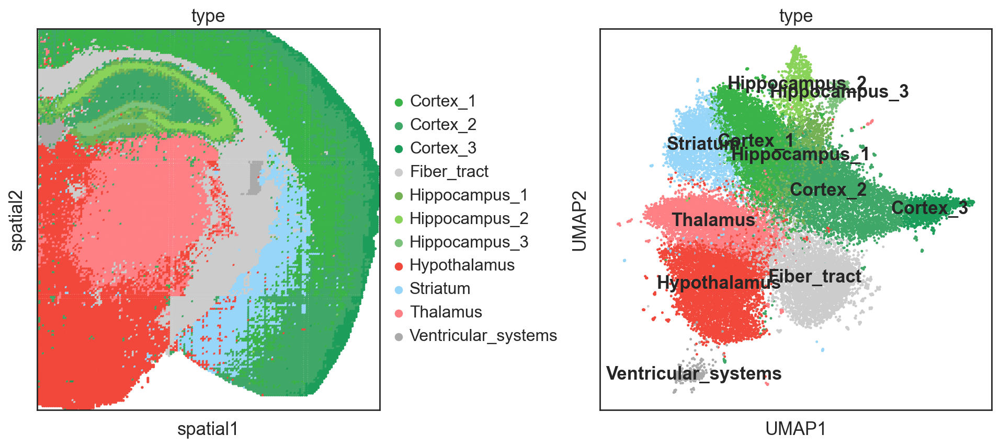

In [303]:


sns.set(style="ticks", font_scale=1.3)
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15,6))
sc.pl.spatial(adata_reg1_filtered, img_key=None,spot_size=26, #alpha=0.8,#wspace=.3,
              color=['type'], cmap='Spectral_r', #vmin='p1',vmax='p99',
             # legend_loc='on data',
              palette=[ '#3ab349','#3fa767', '#1d9d5a', 
                       '#cccccc','#74b155', '#8ad35b' ,
                        '#7cc17c', '#f2483b','#97d6f9', '#fe8084','#aaaaaa'],
              crop_coord= adata_reg1_filtered.uns['crop_coord'],
              ax=axes[0], show=False)

sc.pl.umap(adata_reg1_filtered, legend_loc='on data',size=20, #alpha=0.8,#wspace=.3,
              color=['type'], cmap='Spectral_r', #vmin='p1',vmax='p99',
              ax=axes[1], show=False)

plt.subplots_adjust(wspace=.5,hspace=.2)
plt.savefig('../Figure/Figure2/Figure2-type-interpolation.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')

In [307]:

assignedName = {
    '0':'0', 
        '1':'3',
    '2':'4',
    '3':'1',
    '4':'2',
    '5':'5',
        '6,0':'11',
        '6,1':'8',
            '6,2':'9',
    '7':'6',
    '8':'10'
               }

adata_reg1_filtered.obs['louvain'] = (adata_reg1_filtered.obs['louvain_1'].map(assignedName).astype('category'))
adata_reg1_filtered.obs['louvain']=adata_reg1_filtered.obs['louvain'].cat.set_categories(['0',
 '1',
 '2',
 '3',
 '4',
 '5',
  '6',                                                                        
 '7',
 '8',
 '9',
 '10','11'])

meta NOT subset; don't know how to subset; dropped


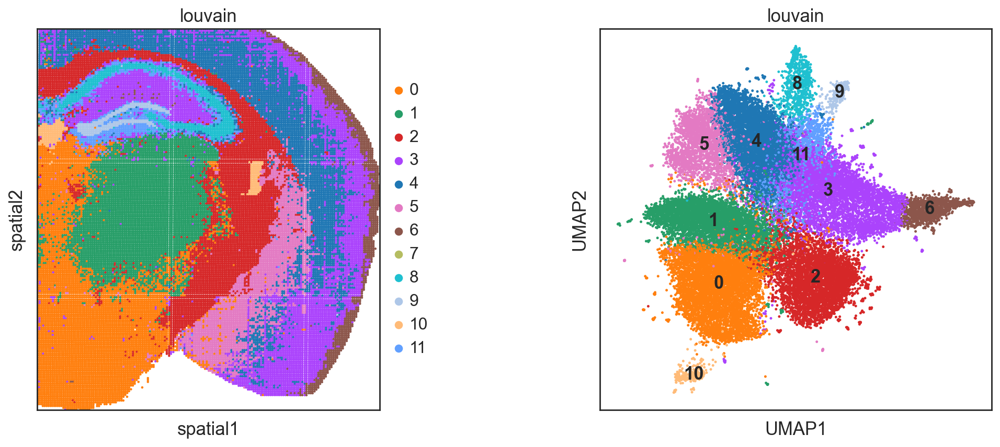

In [308]:


sns.set(style="ticks", font_scale=1.3)
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15,6))
sc.pl.spatial(adata_reg1_filtered, img_key=None,spot_size=22, #alpha=0.8,#wspace=.3,
              color=['louvain'], cmap='Spectral_r', #vmin='p1',vmax='p99',
                           palette=[ '#ff7f0e','#279e68', '#d62728', 
                       '#ab43fc','#1f77b4', '#e37ac3' ,
                        '#8c564b', '#b5bd61','#1fc0d0', '#aec7e8','#ffbb78','#61a0ff'],

              crop_coord= adata_reg1_filtered.uns['crop_coord'],
              ax=axes[0], show=False)

sc.pl.umap(adata_reg1_filtered, legend_loc='on data',size=20, #alpha=0.8,#wspace=.3,
              color=['louvain'], cmap='Spectral_r', #vmin='p1',vmax='p99',
              ax=axes[1], show=False)

plt.subplots_adjust(wspace=.5,hspace=.2)
plt.savefig('../Figure/Figure2/Figure2-type-interpolation-brain.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')

meta NOT subset; don't know how to subset; dropped


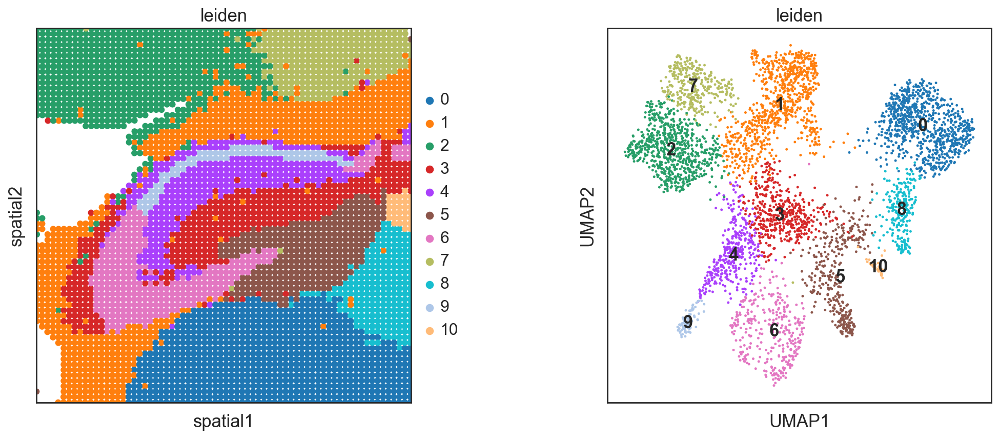

In [309]:


sns.set(style="ticks", font_scale=1.3)
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15,6))
sc.pl.spatial(adata_reg2_filtered, img_key=None,spot_size=35, #alpha=0.8,#wspace=.3,
              color=['leiden'], cmap='Spectral_r', #vmin='p1',vmax='p99',
              crop_coord= adata_reg2_filtered.uns['crop_coord'],
              ax=axes[0], show=False)

sc.pl.umap(adata_reg2_filtered, legend_loc='on data',size=20, #alpha=0.8,#wspace=.3,
              color=['leiden'], cmap='Spectral_r', #vmin='p1',vmax='p99',
              ax=axes[1], show=False)

plt.subplots_adjust(wspace=.5,hspace=.2)
plt.savefig('../Figure/Figure2/Figure2-type-interpolation-brain-S6.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')

## 查看marker Gene

In [310]:
adata_reg1_filtered.uns['log1p']['base']=None
sc.tl.rank_genes_groups(adata_reg1_filtered, groupby='type', method='wilcoxon',use_raw =False)
sc.tl.filter_rank_genes_groups(adata_reg1_filtered)

In [311]:
rank_genes_df_reg = pd.DataFrame(adata_reg1_filtered.uns['rank_genes_groups_filtered']['names'])
print(rank_genes_df_reg.head(10))

  Cortex_1 Cortex_2 Cortex_3 Fiber_tract Hippocampus_1 Hippocampus_2  \
0      NaN      NaN      NaN         NaN           NaN           NaN   
1      Vxn      NaN      NaN         NaN           NaN           NaN   
2      NaN      NaN      NaN         NaN           NaN           NaN   
3  Slc17a7      NaN      NaN         NaN           NaN           NaN   
4      NaN      NaN      NaN         NaN           NaN           NaN   
5      NaN      NaN      NaN         Cnp           NaN           NaN   
6      NaN      NaN      NaN         Mal           Ddn           NaN   
7      NaN      NaN      NaN         NaN        Camk2a       Sipa1l3   
8      NaN      NaN      NaN         NaN           NaN           NaN   
9      NaN      NaN      NaN        Apod           NaN       Cplane1   

  Hippocampus_3 Hypothalamus Striatum       Thalamus Ventricular_systems  
0           NaN          NaN     Penk            NaN                 NaN  
1           NaN          NaN      NaN          Prkcd     

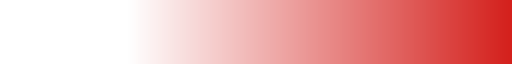

In [312]:
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
nodes = [0, 0.25,1.0]
colors=['white', 'white','#d4201c']
cmap = LinearSegmentedColormap.from_list("mycmap", list(zip(nodes, colors)))
cmap

{'heatmap_ax': <AxesSubplot: >,
 'groupby_ax': <AxesSubplot: xlabel='type'>,
 'gene_groups_ax': <AxesSubplot: >}

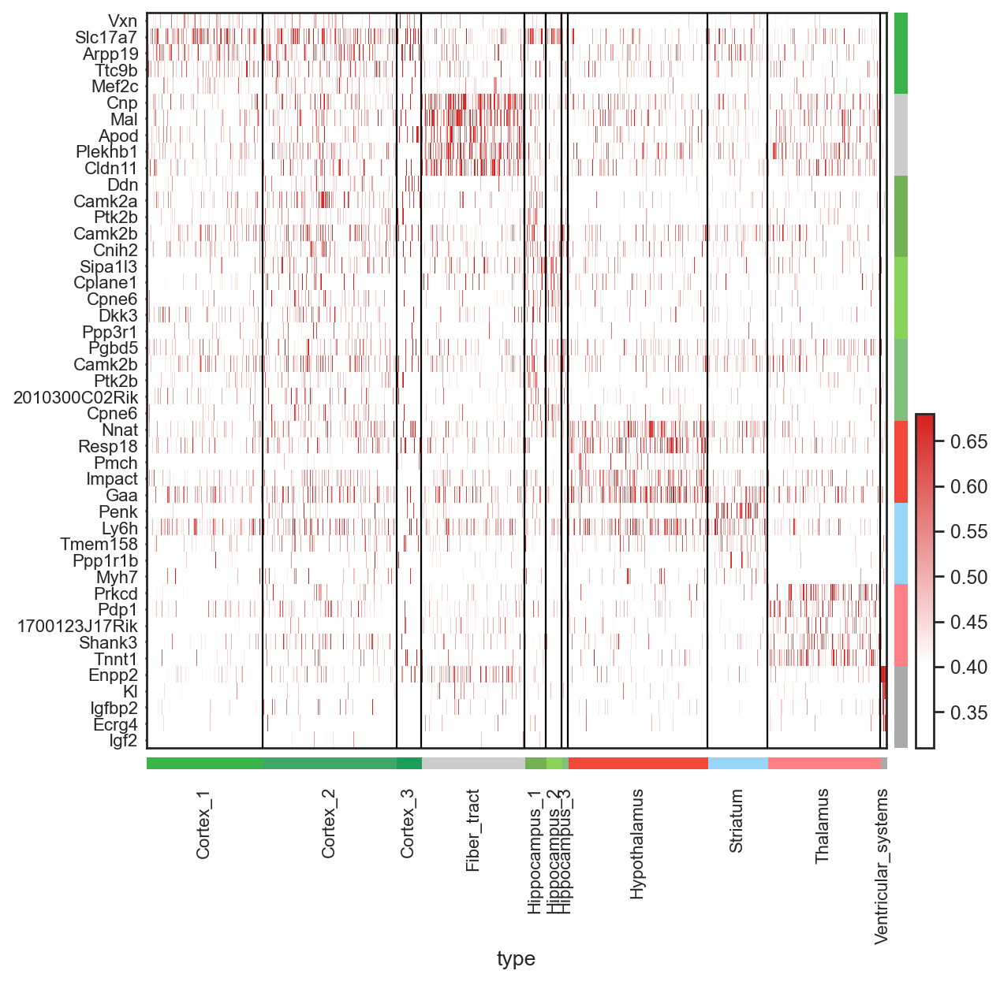

In [313]:
sns.set(style="ticks", font_scale=1)
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['font.sans-serif'] = 'Arial'
sc.pl.rank_genes_groups_heatmap(adata_reg1_filtered,n_genes=5,
                                key='rank_genes_groups_filtered',
                                swap_axes=True,
                                cmap=cmap, dendrogram=False,
                                figsize=(8,8),standard_scale='var',
                                vmin=0.31,vmax=0.68,#save='D:/Task/Zhao_lab/Zhujunjie/file/Fig/Fig5/Fig5-heatmap-top3.pdf',
                               use_raw=False,
                               show=False)
#plt.savefig('D:/Task/Zhao_lab/Zhujunjie/file/Fig/Fig4/Fig4-heatmap-brian.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')

meta NOT subset; don't know how to subset; dropped


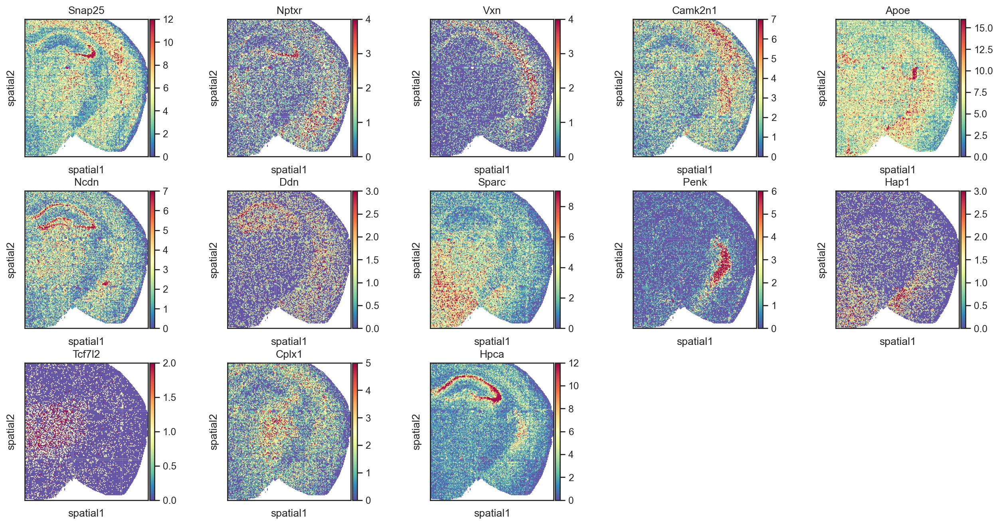

In [314]:
g=['Snap25','Nptxr','Vxn','Camk2n1','Apoe','Ncdn',
  'Ddn','Sparc','Penk','Hap1','Tcf7l2','Cplx1','Hpca']
#'Mbp',



sns.set(style="ticks", font_scale=1)

sc.pl.spatial(adata_reg1_filtered, img_key=None,spot_size=23, #alpha=0.8,#wspace=.3,
              color=g,cmap='Spectral_r',  vmin='p1',vmax='p99',
              legend_loc='on data',use_raw=False,layer='raw',ncols=5,
              crop_coord= adata_reg1_filtered.uns['crop_coord'],
              show=False)

plt.subplots_adjust(hspace=.1,wspace=.01)

plt.savefig('../Figure/Figure2/FigureS6-marker.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')


meta NOT subset; don't know how to subset; dropped


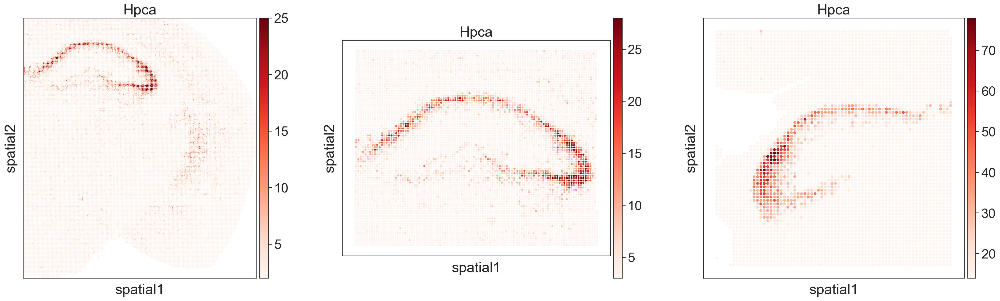

In [315]:
g=['Hpca']

plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['font.sans-serif'] = 'Arial'
plt.rcParams['figure.figsize']=(10,10)
sns.set(style="ticks", font_scale=2)

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(30,8))
sc.pl.spatial(adata_reg1_filtered, img_key=None,spot_size=15, #alpha=0.8,#wspace=.3,
              color=g, cmap='Reds',  vmin='p70',vmax='p99.9',
              legend_loc='on data',use_raw=False,layer='raw',
              crop_coord= adata_reg1_filtered.uns['crop_coord'],
              ax=axes[0], show=False)

sc.pl.spatial(adata_reg1_Hip_filtered, img_key=None,spot_size=15, #alpha=0.8,#wspace=.3,
              color=g,cmap='Reds',  vmin='p70',vmax='p99.9',
              legend_loc='on data',use_raw=False,layer='raw',
              #crop_coord= adata_reg1_filtered.uns['crop_coord'],
              ax=axes[1], show=False)


sc.pl.spatial(adata_reg2_filtered, img_key=None,spot_size=25, #alpha=0.8,#wspace=.3,
              color=g,cmap='Reds',  vmin='p85',vmax='p99.9',
              legend_loc='on data',use_raw=False,layer='raw',
              #crop_coord= adata_reg2_filtered.uns['crop_coord'],
              ax=axes[2], show=False)


plt.subplots_adjust(wspace=.2,hspace=.2)

plt.savefig('../Figure/Figure2/Figure2-Hpca-interpolation.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')


meta NOT subset; don't know how to subset; dropped


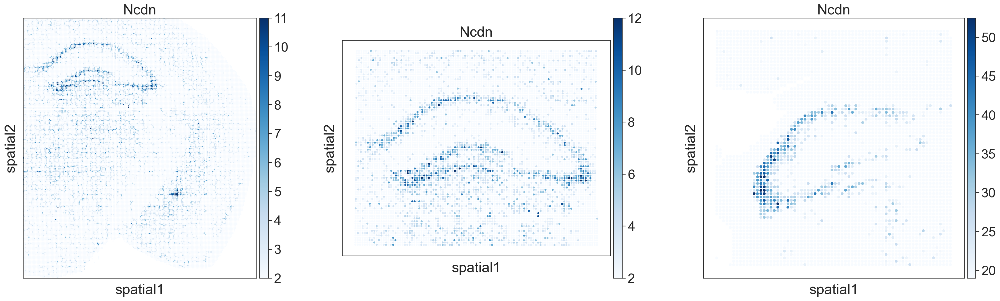

In [316]:
g=['Ncdn']

sns.set(style="ticks", font_scale=2)

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(30,8))
sc.pl.spatial(adata_reg1_filtered, img_key=None,spot_size=15, #alpha=0.8,#wspace=.3,
              color=g, cmap='Blues',  vmin='p70',vmax='p99.9',
              legend_loc='on data',use_raw=False,layer='raw',
              crop_coord= adata_reg1_filtered.uns['crop_coord'],
              ax=axes[0], show=False)

sc.pl.spatial(adata_reg1_Hip_filtered, img_key=None,spot_size=15, #alpha=0.8,#wspace=.3,
              color=g, cmap='Blues',  vmin='p70',vmax='p99.9',
              legend_loc='on data',use_raw=False,layer='raw',
              #crop_coord= adata_reg1_filtered.uns['crop_coord'],
              ax=axes[1], show=False)


sc.pl.spatial(adata_reg2_filtered, img_key=None,spot_size=25, #alpha=0.8,#wspace=.3,
              color=g, cmap='Blues',  vmin='p85',vmax='p99.9',
              legend_loc='on data',use_raw=False,layer='raw',
              #crop_coord= adata_reg2_filtered.uns['crop_coord'],
              ax=axes[2], show=False)


plt.subplots_adjust(wspace=.2,hspace=.2)

plt.savefig('../Figure/Figure2/Figure2-Ncdn-interpolation.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')


In [317]:
all_gene=list(set(adata_reg1_Hip_filtered.var_names) & set(adata_reg2_filtered.var_names)) 
               
df_gene_sum=pd.DataFrame(np.log(pd.DataFrame(adata_reg1_Hip_filtered.raw.X.toarray(),index=adata_reg1_Hip_filtered.obs_names,columns=adata_reg1_Hip_filtered.var_names).loc[:,all_gene].sum(0)),columns=['adata_reg1_Hip'])

df_gene_sum['adata_reg2_Hip']=np.log(list((pd.DataFrame(adata_reg2_filtered.raw.X.toarray(),index=adata_reg2_filtered.obs_names,columns=adata_reg2_filtered.var_names).loc[:,all_gene].sum(0))))
       

In [318]:
df_cor_spearman=df_gene_sum.corr(method ='spearman')
df_cor_pearson=df_gene_sum.corr(method ='pearson')

In [319]:
df_cor_spearman

,adata_reg1_Hip,adata_reg2_Hip
adata_reg1_Hip,1.000000,0.953461
adata_reg2_Hip,0.953461,1.000000


In [320]:
df_cor_pearson

,adata_reg1_Hip,adata_reg2_Hip
adata_reg1_Hip,1.00000,0.94897
adata_reg2_Hip,0.94897,1.00000


meta NOT subset; don't know how to subset; dropped


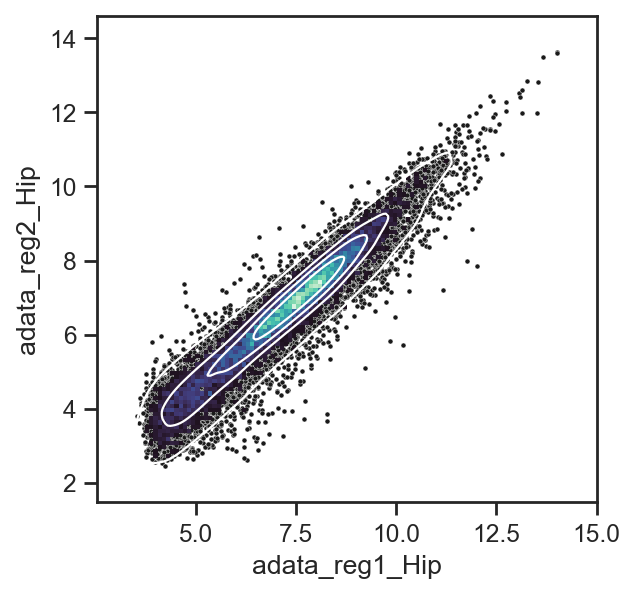

In [323]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.pyplot as plt
sns.set(style='ticks')
plt.figure(figsize=(4,4))

#f, ax = plt.subplots(figsize=(6, 6))
sns.scatterplot(data=df_gene_sum,x='adata_reg1_Hip', y='adata_reg2_Hip', s=5, color=".1")
sns.histplot(data=df_gene_sum,x='adata_reg1_Hip', y='adata_reg2_Hip', bins=100, pthresh=.1, cmap="mako")
sns.kdeplot(data=df_gene_sum,x='adata_reg1_Hip', y='adata_reg2_Hip',levels=5, color="w", linewidths=1)
plt.show()

# 四、 Neighborhood enrichment analysis

In [324]:
import random
import colorsys

def get_max_column(row):
    return row.idxmax()

adata_reg1_filtered.obs['Cell_type'] = adata_reg1_filtered.obs[adata_st1.uns['mod']['factor_names']].apply(get_max_column, axis=1)
adata_reg2_filtered.obs['Cell_type'] = adata_reg2_filtered.obs[adata_st6.uns['mod']['factor_names']].apply(get_max_column, axis=1)


def get_random_hex_colors(num_colors):
    colors = []
    for i in range(num_colors):
        r = random.randint(0, 255)
        g = random.randint(0, 255)
        b = random.randint(0, 255)
        hex_color = f'#{r:02x}{g:02x}{b:02x}'
        colors.append(hex_color)
    
    return colors

hex_colors = get_random_hex_colors(60)

print(hex_colors)

['#e4c20b', '#9f37dd', '#1e8d47', '#ca5b3c', '#a84108', '#07ef43', '#003ea9', '#e77899', '#851efe', '#a8440f', '#6e6d42', '#4d1b86', '#3d5b65', '#78c97e', '#bb3498', '#e5f2dc', '#fb8496', '#6ac2c0', '#f2b140', '#5c2b75', '#02c284', '#ba59d4', '#8b16a6', '#0c5683', '#93f05f', '#7b6435', '#48ad0b', '#0d5e01', '#ae78d4', '#8c2f90', '#a3d93e', '#292f56', '#b2009e', '#84b174', '#c8ac39', '#2d424f', '#0bebe3', '#7f2813', '#5e61f0', '#89a7e5', '#ec58c5', '#b2a0e6', '#cc9b0f', '#ccee20', '#1cc540', '#dcdca3', '#58a7ad', '#a5c7f6', '#dc3f60', '#e9b564', '#0b86e6', '#e9e3d2', '#b5950f', '#7b3d54', '#d62893', '#a1ad6b', '#cda3e8', '#d0db19', '#716c38', '#5116df']


In [358]:
def rgb2hex(r,g,b):
    hex_color = f'#{r:02x}{g:02x}{b:02x}'
    return hex_color


# Create linearly scaled colormaps
YellowCM = rgb2hex(240, 228, 66)  # #F0E442 ['#F0E442', '#D55E00', '#56B4E9',
# '#009E73', '#5A14A5', '#C8C8C8', '#323232']
RedCM = rgb2hex(213, 94, 0)  # #D55E00
BlueCM = rgb2hex(86, 180, 233)  # #56B4E9
GreenCM = rgb2hex(0, 158, 115)  # #009E73
GreyCM = rgb2hex(254,196,7)  # #C8C8C8
WhiteCM = rgb2hex(188,189,220)  # #323232
PurpleCM = rgb2hex(90, 20, 165)  # #5A14A5
B1CM = rgb2hex(127,201,127)  # #7fc97f

B2CM = rgb2hex(140,81,10)  # #543005
B3CM = rgb2hex(197,27,125)  # #c51b7d
B4CM = rgb2hex(178,24,43)  # #b2182b
B5CM = rgb2hex(67,147,195)  # #4393c3
B6CM = rgb2hex(53,151,143)  # #35978f
B7CM = rgb2hex(247,252,185)  # #f7fcb9
B8CM = rgb2hex(222,203,228)  # #decbe4
B9CM = rgb2hex(253,218,236)  # #fddaec

cmaps = [GreenCM,RedCM,YellowCM,BlueCM,PurpleCM,B2CM,B3CM,B5CM,GreyCM,WhiteCM,B1CM,B4CM,B6CM,B7CM,B8CM,B9CM,
    GreenCM,RedCM,YellowCM,BlueCM,PurpleCM,B2CM,B3CM,B5CM,GreyCM,WhiteCM,B1CM,B4CM,B6CM,B7CM,B8CM,B9CM,
    GreenCM,RedCM,YellowCM,BlueCM,PurpleCM,B2CM,B3CM,B5CM,GreyCM,WhiteCM,B1CM,B4CM,B6CM,B7CM,B8CM,B9CM,
    GreenCM,RedCM,YellowCM,BlueCM,PurpleCM,B2CM,B3CM]

In [361]:
df_cmap=pd.DataFrame({'Cell_type':list(df_cell_count.index),
                     'color':cmaps[0:55]})
df_cmap.index=df_cmap['Cell_type']

In [362]:
a=list(set(adata_reg1_filtered.obs['Cell_type']))
a.sort()
cmap1=list(df_cmap.loc[a,:]['color'])

a=list(set(adata_reg2_filtered.obs['Cell_type']))
a.sort()
cmap2=list(df_cmap.loc[a,:]['color'])

In [367]:
a=df_cell_count['count'].index[0:20]
a=df_cell_count['count'].index[df_cell_count['count']>10]
len(a)

47

In [370]:
b=df_cell_count6['count'].index[0:20]
b=df_cell_count6['count'].index[df_cell_count6['count']>10]
len(b)

24

In [371]:
adata_reg1=adata_reg1_filtered.copy()
adata_reg2=adata_reg2_filtered.copy()

In [372]:
adata_reg11=adata_reg1[[2500>i>700 for i in adata_reg1.obs['Pixel_col']]]
adata_reg11=adata_reg11[ [2500>i>300 for i in adata_reg11.obs['Pixel_row']]]

In [373]:
adata_reg1=adata_reg1[adata_reg1.obs['Cell_type'].isin(a)]
adata_reg2=adata_reg2[adata_reg2.obs['Cell_type'].isin(b)]

adata_reg11=adata_reg11[adata_reg11.obs['Cell_type'].isin(b)]

In [374]:
len(b)

24

In [375]:
sq.gr.spatial_neighbors(adata_reg1)
sq.gr.spatial_neighbors(adata_reg2)
sq.gr.spatial_neighbors(adata_reg11)

In [376]:

sq.gr.nhood_enrichment(adata_reg1, cluster_key="Cell_type")
sq.gr.nhood_enrichment(adata_reg2, cluster_key="Cell_type")
sq.gr.nhood_enrichment(adata_reg11, cluster_key="Cell_type")

  0%|          | 0/1000 [00:00<?, ?/s]

  0%|          | 0/1000 [00:00<?, ?/s]

  0%|          | 0/1000 [00:00<?, ?/s]

In [377]:
a=list(set(adata_reg1.obs['Cell_type']))
a.sort()
cmap1=list(df_cmap.loc[a,:]['color'])

a=list(set(adata_reg2.obs['Cell_type']))
a.sort()
cmap2=list(df_cmap.loc[a,:]['color'])

meta NOT subset; don't know how to subset; dropped


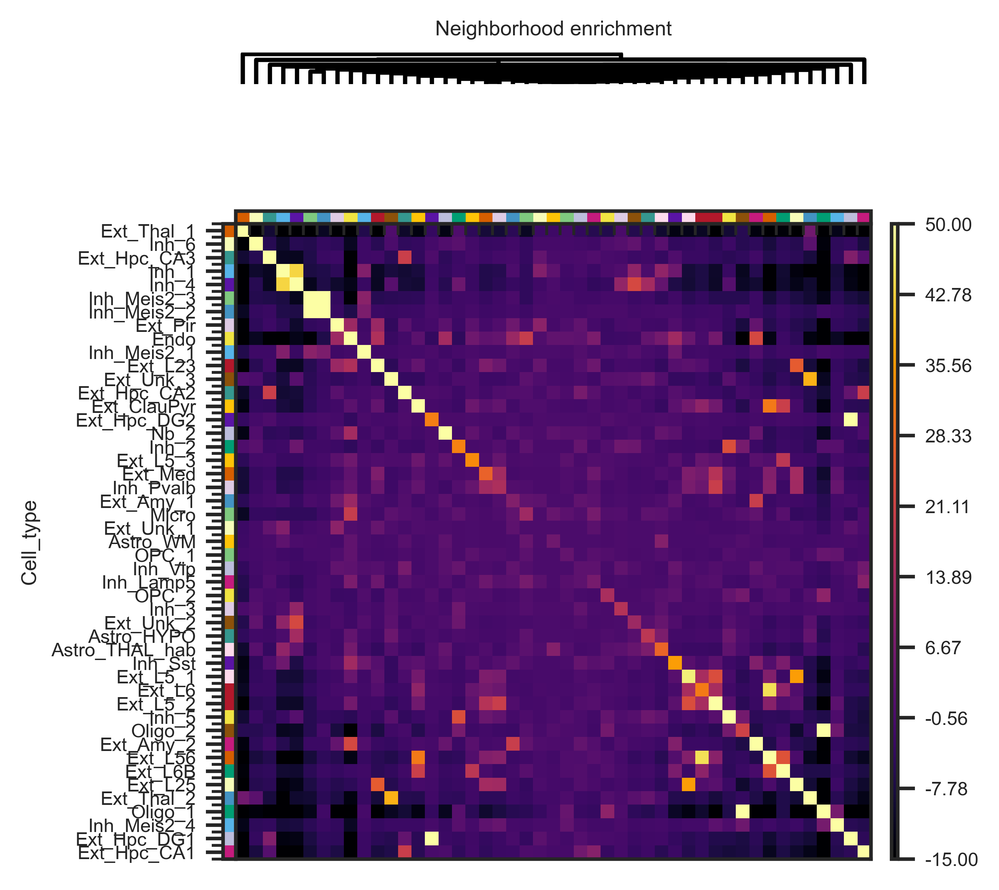

In [402]:

sns.set(style="ticks", font_scale=0.6)
sq.pl.nhood_enrichment(
    adata_reg1,
    cluster_key="Cell_type",
    method="single", 
    cmap="inferno",figsize=(4, 4),
    palette=cmap1, vmin=-15, vmax=50,
    dpi=300
)
plt.savefig('../Figure/Figure2/Figure2-reg1-nhood_enrichment-ALL.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')

meta NOT subset; don't know how to subset; dropped


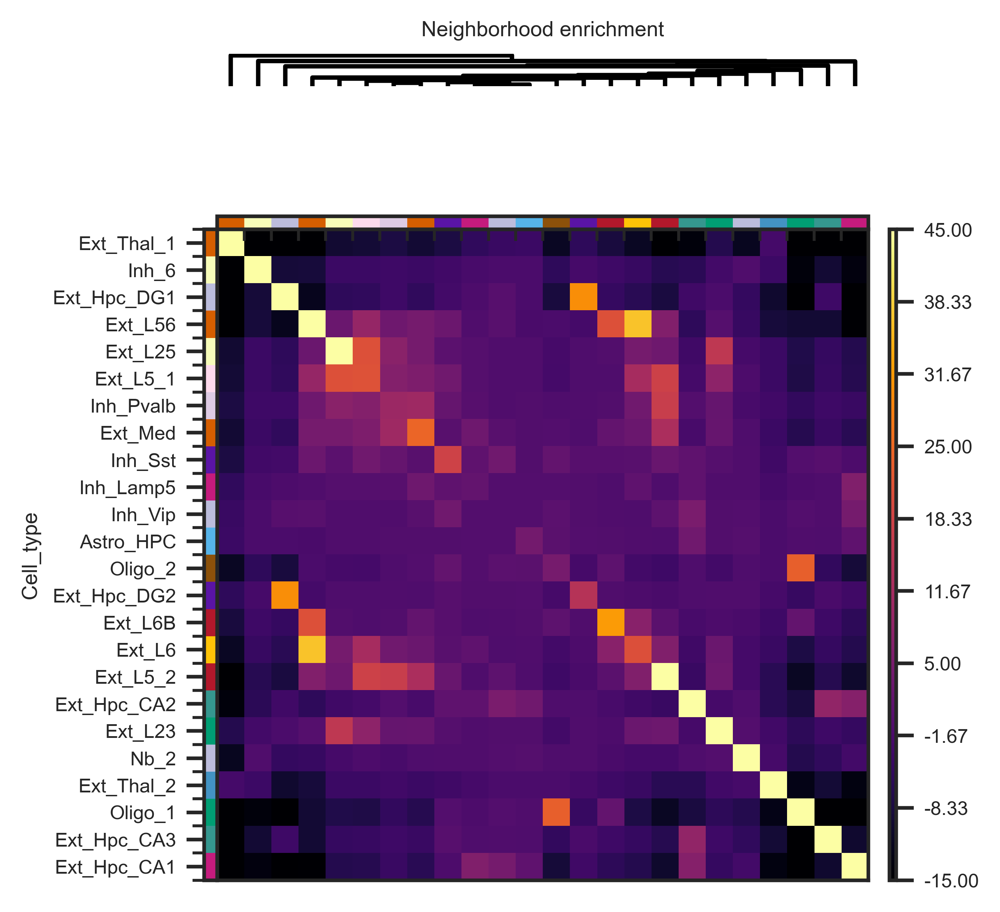

In [401]:

sns.set(style="ticks", font_scale=0.6)
sq.pl.nhood_enrichment(
    adata_reg11,
    method="single", 
    cluster_key="Cell_type",
    cmap="inferno",
    figsize=(4, 4),
    palette=cmap2, vmin=-15, vmax=45,
    dpi=300
)
plt.savefig('../Figure/Figure2/Figure2-reg11-nhood_enrichment-ALL.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')

meta NOT subset; don't know how to subset; dropped


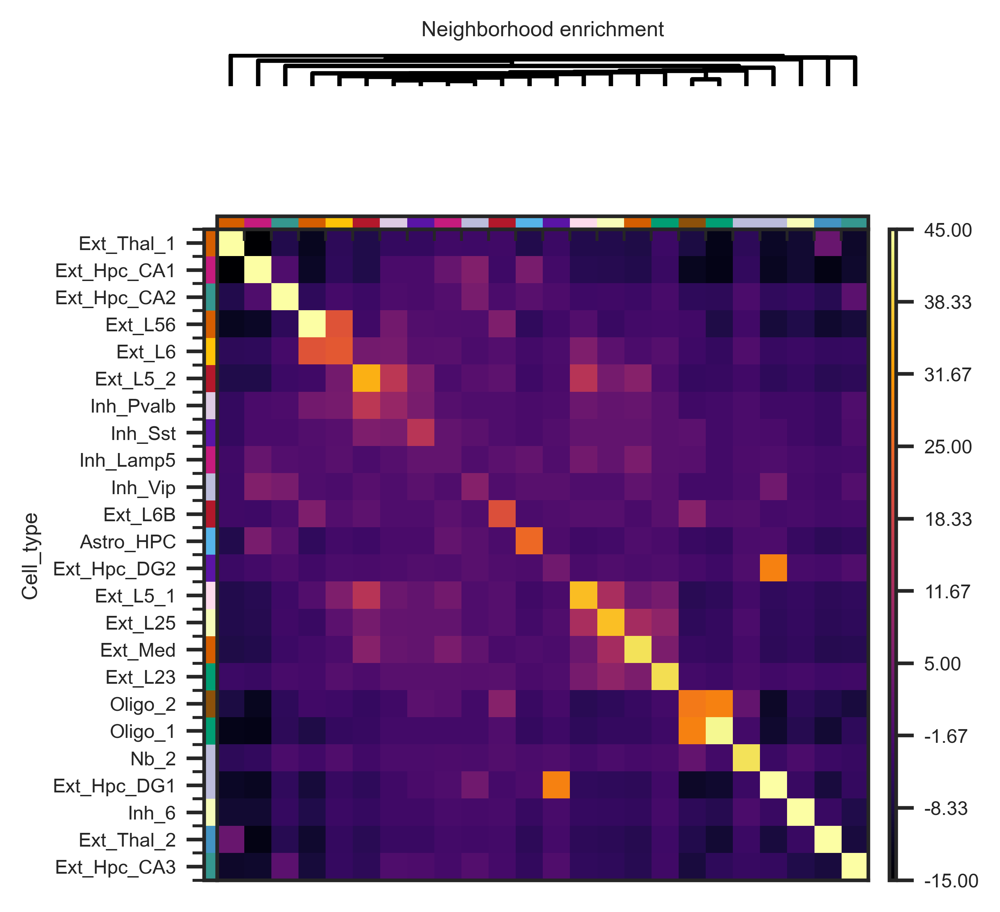

In [400]:

sns.set(style="ticks", font_scale=0.6)
sq.pl.nhood_enrichment(
    adata_reg2,
    method="single", 
    cluster_key="Cell_type",
    cmap="inferno",
    figsize=(4, 4),
    palette=cmap2, vmin=-15, vmax=45,
    dpi=300
)

plt.savefig('../Figure/Figure2/Figure2-reg2-nhood_enrichment-ALL.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')

In [382]:
mode = "L"
sq.gr.ripley(adata_reg1, cluster_key="Cell_type", mode=mode)
#sq.pl.ripley(adata_reg1_filtered, cluster_key="Cell_type", mode=mode)
sq.gr.ripley(adata_reg11, cluster_key="Cell_type", mode=mode)
#sq.pl.ripley(adata_reg2_filtered, cluster_key="Cell_type", mode=mode)

sq.gr.ripley(adata_reg2, cluster_key="Cell_type", mode=mode)
#sq.pl.ripley(adata_reg2_filtered, cluster_key="Cell_type", mode=mode)

In [383]:
def remove_duplicates(input_list):
    new_list = []
    for element in input_list:
        if element not in new_list:
            new_list.append(element)
    return new_list
reg1_L_stat=remove_duplicates(adata_reg1.uns['Cell_type_ripley_L']['L_stat'].sort_values(['stats'],ascending=False)['Cell_type'])
reg11_L_stat=remove_duplicates(adata_reg11.uns['Cell_type_ripley_L']['L_stat'].sort_values(['stats'],ascending=False)['Cell_type'])
reg2_L_stat=remove_duplicates(adata_reg2.uns['Cell_type_ripley_L']['L_stat'].sort_values(['stats'],ascending=False)['Cell_type'])


meta NOT subset; don't know how to subset; dropped


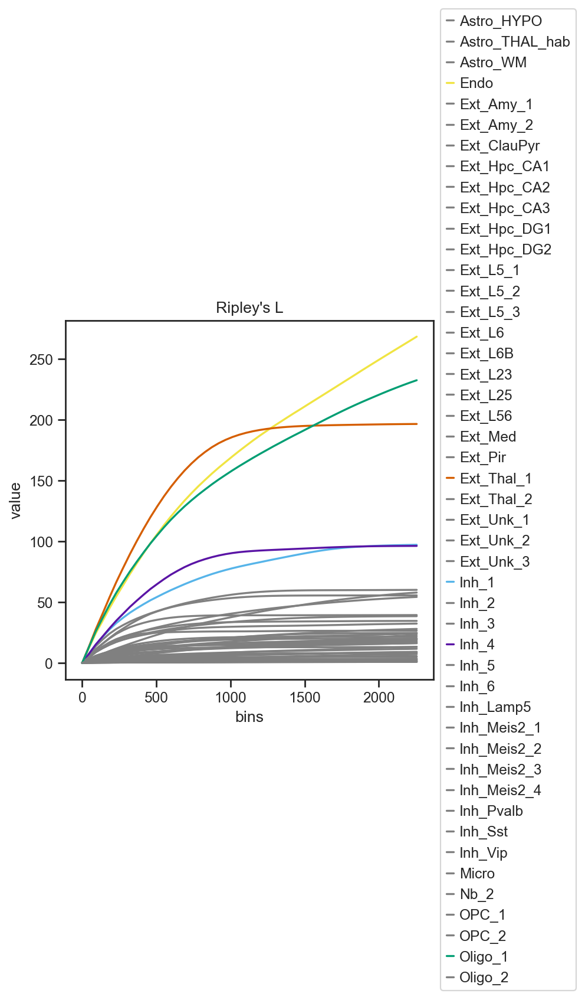

In [397]:
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
df_cmap_1=df_cmap.loc[reg1_L_stat,]
df_cmap_1.index.name=None
df_cmap_1=df_cmap_1.sort_values(['Cell_type'])
df_cmap_1['new_color']='grey'
df_cmap_1['new_color'][df_cmap_1['Cell_type'].isin(reg1_L_stat[0:5])]=df_cmap_1['color'][df_cmap_1['Cell_type'].isin(reg1_L_stat[0:5])]
df_cmap_1=df_cmap_1.loc[list(adata_reg1.obs['Cell_type'].cat.categories),:]
#adata_reg1.uns['Cell_type_colors']=np.array(df_cmap_1['new_color'])
sns.set(style="ticks", font_scale=1)
sq.pl.ripley(adata_reg1, cluster_key="Cell_type",plot_sims=False,
            palette=list(df_cmap_1['new_color']),
             mode=mode,figsize=(5, 5))
plt.savefig('../Figure/Figure2/Figure2-reg1-ripley-new.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')

meta NOT subset; don't know how to subset; dropped


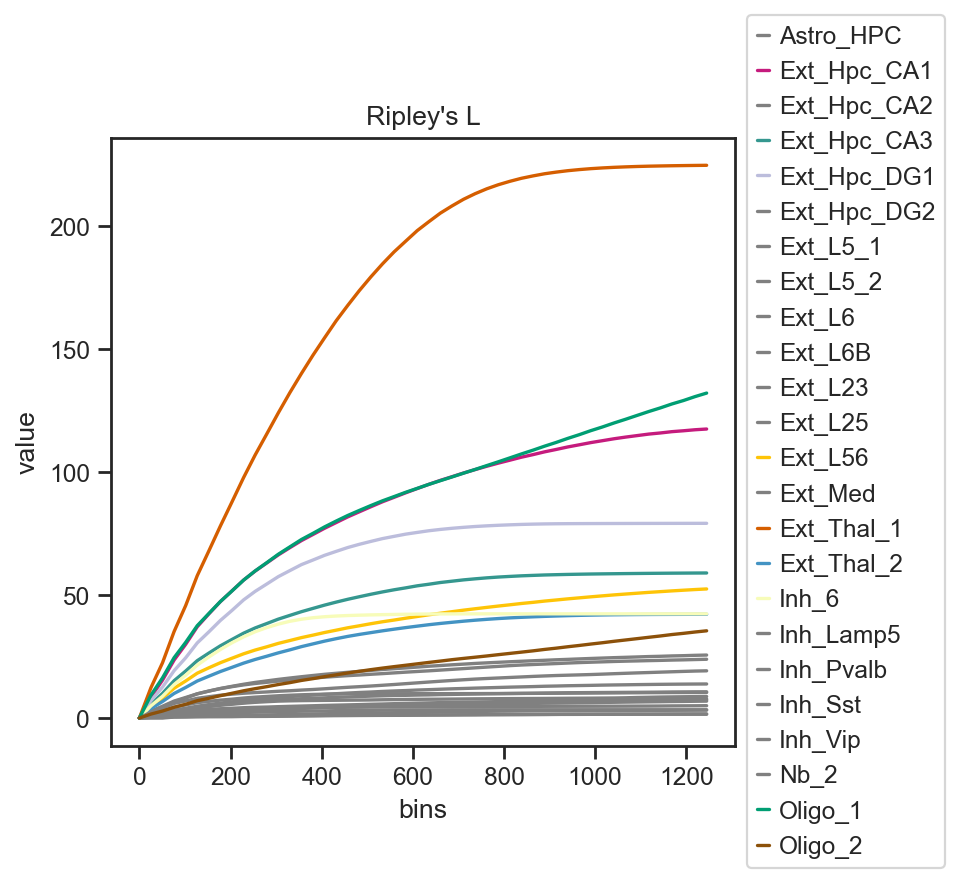

In [398]:
df_cmap_2=df_cmap.loc[reg11_L_stat,]
df_cmap_2.index.name=None
df_cmap_2=df_cmap_2.sort_values(['Cell_type'])
df_cmap_2['new_color']='grey'
df_cmap_2['new_color'][df_cmap_2['Cell_type'].isin(reg11_L_stat[0:9])]=df_cmap_2['color'][df_cmap_2['Cell_type'].isin(reg11_L_stat[0:9])]
df_cmap_2=df_cmap_2.loc[list(adata_reg2.obs['Cell_type'].cat.categories),:]
#adata_reg2.uns['Cell_type_colors']=np.array(df_cmap_2['new_color'])
sq.pl.ripley(adata_reg11, cluster_key="Cell_type",
             palette=list(df_cmap_2['new_color']),
             plot_sims=False,
             mode=mode,figsize=(5, 5))
plt.savefig('../Figure/Figure2/Figure2-reg11-ripley-new.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')

meta NOT subset; don't know how to subset; dropped


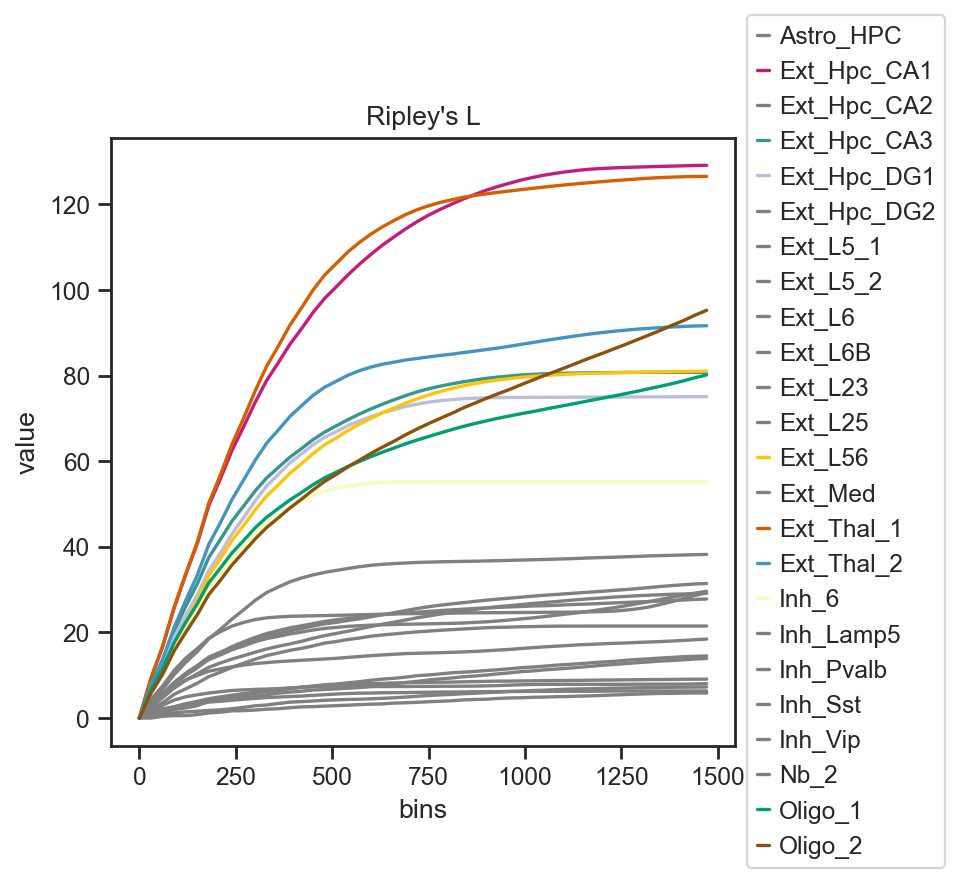

In [399]:
df_cmap_2=df_cmap.loc[reg2_L_stat,]
df_cmap_2.index.name=None
df_cmap_2=df_cmap_2.sort_values(['Cell_type'])
df_cmap_2['new_color']='grey'
df_cmap_2['new_color'][df_cmap_2['Cell_type'].isin(reg2_L_stat[0:9])]=df_cmap_2['color'][df_cmap_2['Cell_type'].isin(reg2_L_stat[0:9])]
df_cmap_2=df_cmap_2.loc[list(adata_reg2.obs['Cell_type'].cat.categories),:]
#adata_reg2.uns['Cell_type_colors']=np.array(df_cmap_2['new_color'])
sq.pl.ripley(adata_reg2, cluster_key="Cell_type",
             palette=list(df_cmap_2['new_color']),
             plot_sims=False,
             mode=mode,figsize=(5, 5))
plt.savefig('../Figure/Figure2/Figure2-reg2-ripley-new.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')

meta NOT subset; don't know how to subset; dropped


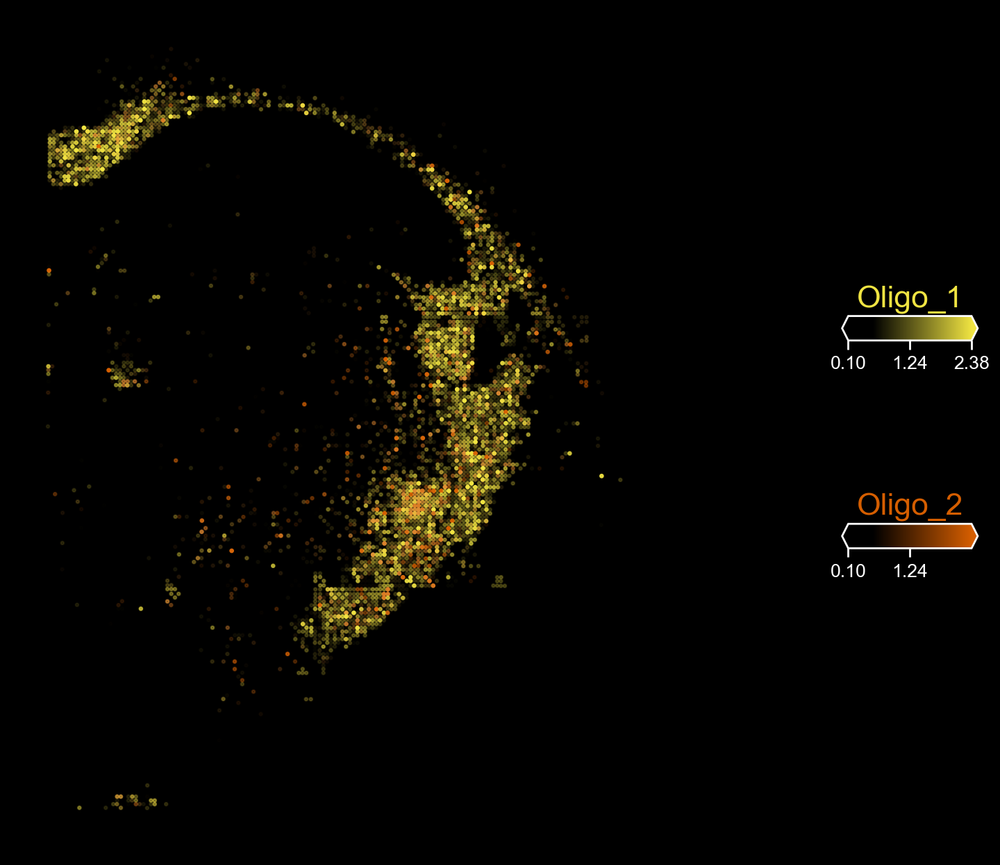

In [404]:
# Now we use cell2location plotter that allows showing multiple cell types in one panel
#from cell2location.plt import plot_spatial

# select up to 6 clusters
clust_labels = ["Oligo_1","Oligo_2"]

clust_col = ['' + str(i) for i in clust_labels] # in case column names differ from labels


with mpl.rc_context({'figure.figsize': (12, 10)}):
    fig = plot_spatial(
        adata=adata_reg1,
        # labels to show on a plot
        color=clust_col, labels=clust_labels,
        show_img=False,
        # 'fast' (white background) or 'dark_background'
       style='dark_background',
        # limit color scale at 99.2% quantile of cell abundance
        min_color_quantile=0.10,
        max_color_quantile=0.998,
        # size of locations (adjust depending on figure size)
        circle_diameter=2,
        colorbar_position='right'
    )
plt.savefig('../Figure/Figure2/Figure2-Oligo-interpolation.pdf', dpi = 600, transparent=True, format = 'pdf', bbox_inches='tight')

meta NOT subset; don't know how to subset; dropped


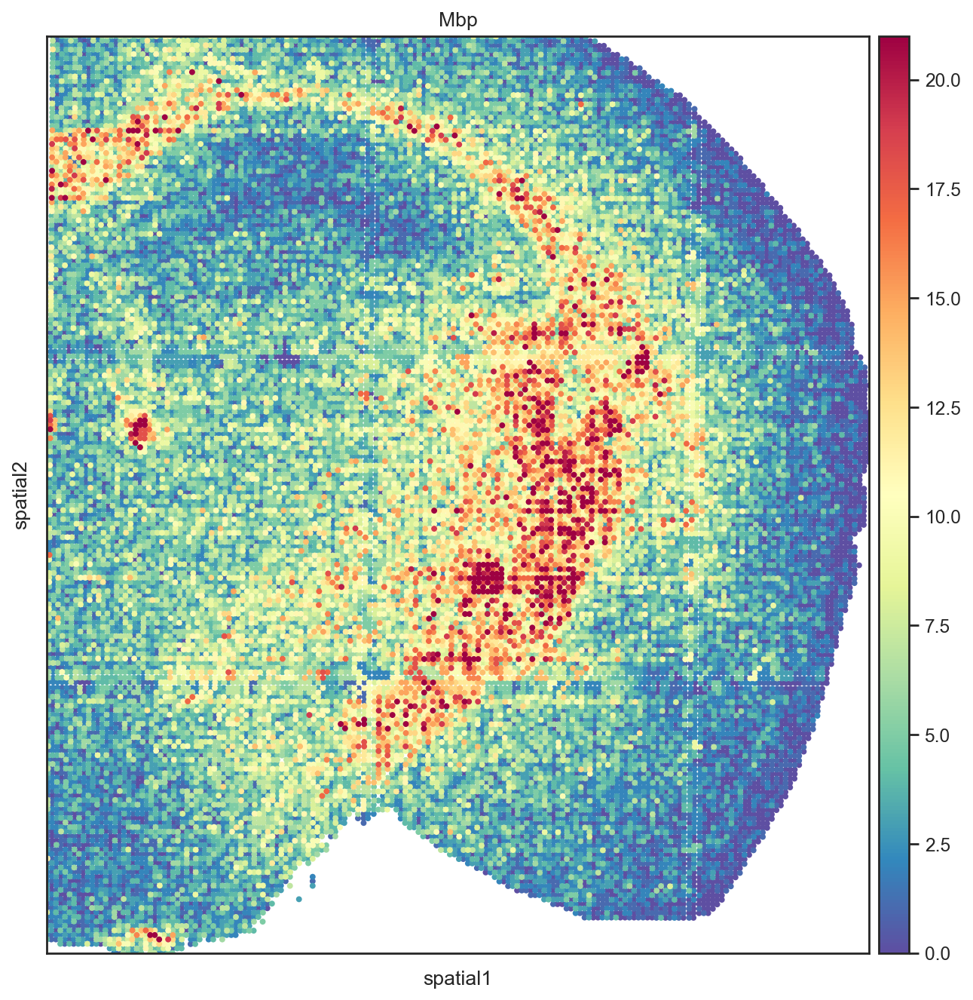

In [407]:
sns.set(style="ticks", font_scale=1)

sc.pl.spatial(adata_reg1_filtered, img_key=None,spot_size=23, #alpha=0.8,#wspace=.3,
              color='Mbp',cmap='Spectral_r',  vmin='p1',vmax='p99',
              legend_loc='on data',use_raw=False,layer='raw',ncols=5,
              crop_coord= adata_reg1_filtered.uns['crop_coord'],
              show=False)

plt.savefig('../Figure/Figure2/Figure2-Mbp.pdf', dpi = 600, transparent=True, format = 'pdf', bbox_inches='tight')